In [1]:
import tensorflow as tf
import os
import numpy as np
import matplotlib.pyplot as plt
import time
import cv2
from tensorflow.keras import layers
from keras.models import Model, Sequential
from tensorflow.keras.applications import VGG19
from keras.layers import Dense, Conv2D, Flatten, BatchNormalization, LeakyReLU
from keras.layers import Conv2DTranspose, Dropout, ReLU, Input, Concatenate, ZeroPadding2D
from keras.optimizers import Adam
from keras.utils import plot_model
# from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow_addons as tfa

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"
/opt/conda/lib/python3.10/site-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


In [2]:
import tensorflow as tf

physical_devices = tf.config.list_physical_devices('GPU')
if len(physical_devices) == 0:
    print("No GPU devices found. Make sure your GPU is properly installed and configured.")
else:
    tf.config.experimental.set_memory_growth(physical_devices[0], True)
    print("GPU configured successfully.")

GPU configured successfully.


In [3]:
import tensorflow as tf

# Check available GPUs
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    # Restrict TensorFlow to only allocate GPU memory growth
    try:
        tf.config.experimental.set_memory_growth(gpus[0], True)
        print("GPU memory growth set to True")
    except RuntimeError as e:
        print(e)

GPU memory growth set to True


In [4]:
import tensorflow as tf

# Check if TensorFlow can access GPU
num_gpus = len(tf.config.experimental.list_physical_devices('GPU'))

if num_gpus > 0:
    print("Num GPUs Available: ", num_gpus)
    print("TensorFlow is using GPU.")
else:
    print("No GPU available. TensorFlow is using CPU.")

Num GPUs Available:  1
TensorFlow is using GPU.


In [5]:
def load(image_file):
    image = tf.io.read_file(image_file)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.cast(image,tf.float32)
    return image

In [6]:
path = "/kaggle/input/coco2017/"
x = load(os.path.join(path, 'train2017/train2017/000000000072.jpg'))
print(x.shape)

(640, 427, 3)


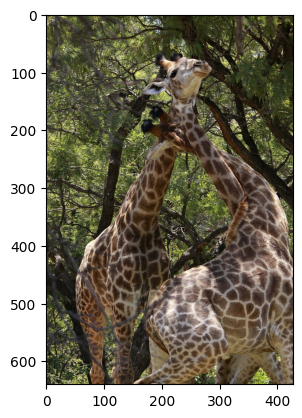

In [7]:
plt.imshow(x/255.0)

In [8]:
def normalize(real_image):
    real_image = (real_image / 255)
    return real_image

In [9]:
def random_crop(real_image):
    cropped_image = tf.image.random_crop(real_image, size = [256, 256, 3])
    return cropped_image

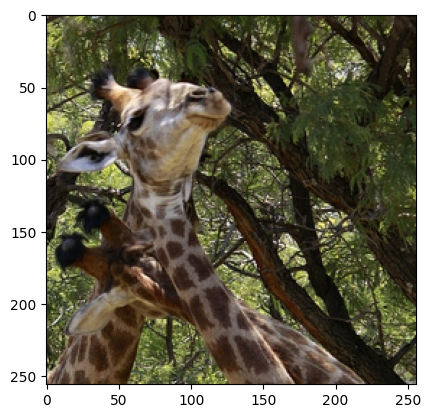

In [10]:
x_aug = random_crop(x)
plt.imshow(x_aug/255.0)

In [11]:
def resize(real_image):
    real_image = tf.image.resize(real_image, [256, 256], method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
    return real_image

In [12]:
def rotate_image(image, angles, interpolation='BILINEAR'):
    """
    Rotate an image tensor by specified angles.

    Args:
    - image: Input image tensor with shape (batch_size, height, width, channels).
    - angles: Tensor of rotation angles in radians for each image in the batch.
    - interpolation: Interpolation method ('BILINEAR' or 'NEAREST').

    Returns:
    - Rotated image tensor.
    """
    batch_size, height, width, channels = tf.unstack(tf.shape(image))

    # Coordinates of the center of the image
    center_x = tf.cast(width, tf.float32) / 2.0
    center_y = tf.cast(height, tf.float32) / 2.0

    # Define transformation matrix
    rotation_matrix = tf.reshape(tf.stack([tf.cos(angles), -tf.sin(angles), center_x * (1 - tf.cos(angles)) + center_y * tf.sin(angles),
                                           tf.sin(angles), tf.cos(angles), -center_x * tf.sin(angles) + center_y * (1 - tf.cos(angles)),
                                           0.0, 0.0, 1.0], axis=1), shape=(-1, 3, 3))

    # Apply rotation to each pixel
    rotated_image = tfa.image.transform(image, rotation_matrix, interpolation)

    return rotated_image


In [13]:
def random_jitter(real_image):
    if tf.random.uniform(()) > 0.5:
        real_image = tf.image.flip_left_right(real_image)
    return real_image

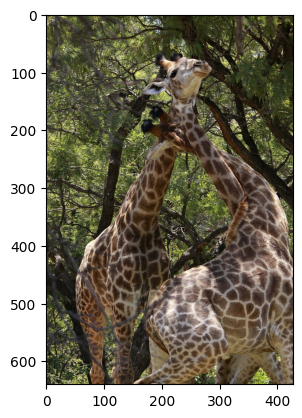

In [14]:
x_jitter = random_jitter(x)
plt.imshow(x_jitter/255.0)

In [15]:
def resize_with_aspect_ratio(image, constant_size):
        # Get image dimensions
        height, width = tf.shape(image)[0], tf.shape(image)[1]

        # Calculate aspect ratio
        aspect_ratio = tf.cast(width, tf.float32) / tf.cast(height, tf.float32)

        # Determine new dimensions based on constant size
        new_height = tf.cond(aspect_ratio >= 1.0,
                             lambda: constant_size,
                             lambda: tf.cast(constant_size / aspect_ratio, tf.int32))
        new_width = tf.cond(aspect_ratio >= 1.0,
                            lambda: tf.cast(constant_size * aspect_ratio, tf.int32),
                            lambda: constant_size)

        # Resize the image
        resized_image = tf.image.resize(image, [new_height, new_width])

        return resized_image

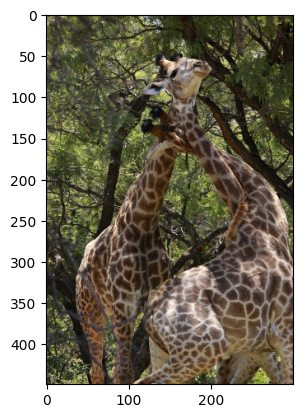

In [16]:
plt.imshow(resize_with_aspect_ratio(x,300)/255)

In [17]:
def load_train_images(image_path):
    real_image = load(image_path)
    real_image = resize_with_aspect_ratio(real_image, 300)
#     real_image = tf.image.resize(real_image, [256, 256], method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
    real_image = tf.image.random_brightness(real_image, 0.2)
    real_image = random_crop(real_image)
    # Define the rotation angle in radians
    rotation_angle = tf.constant(20.0 * (3.141592653589793 / 180.0), dtype=tf.float32)

    # Apply the rotation using tfa.image.rotate
    real_image = tfa.image.rotate(real_image, angles=rotation_angle)

#     # Example usage
#     angles = tf.placeholder(dtype=tf.float32, shape=(None,))
#     # Specify the rotation range in degrees
#     rotation_range = 15  # Adjust this value as needed
#     # Convert the rotation range to radians
#     rotation_range_rad = rotation_range * (np.pi / 180.0)
#     # Generate random rotation angles for each image in the batch
#     random_angles = tf.random.uniform(shape=(tf.shape(image)[0],), minval=-rotation_range_rad, maxval=rotation_range_rad)
#     # Apply custom rotation to the image with bilinear interpolation
#     real_image = rotate_image(real_image, random_angles, interpolation='BILINEAR')
    #     real_image = rotate(real_image)
    real_image = random_jitter(real_image)
    real_image = normalize(real_image)
    yuv_image = tf.image.rgb_to_yuv(real_image)
    # Separate LAB into L and AB components
    Y_channel = tf.expand_dims(yuv_image[:, :, 0], axis=-1)  # L channel
    UV_channels = yuv_image[:, :, 1:]  # AB channels
    #here L_channel becomes input i.e light/luminance of pixel and AB_channels become target
    return Y_channel, UV_channels

In [18]:
def load_test_image(image_path):
    real_image = load(image_path)
    real_image = resize_with_aspect_ratio(real_image, 256)
#     real_image = tf.image.resize(real_image, [256, 256], method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
#     real_image = tf.image.random_brightness(real_image, 0.2)
    real_image = random_crop(real_image)
    real_image = normalize(real_image)
    yuv_image = tf.image.rgb_to_yuv(real_image)
    # Separate LAB into L and AB components
    Y_channel = tf.expand_dims(yuv_image[:, :, 0], axis=-1)  # L channel
    UV_channels = yuv_image[:, :, 1:]  # AB channels
    #here L_channel becomes input i.e light/luminance of pixel and AB_channels become target
    return Y_channel, UV_channels

In [19]:
IMAGE_SIZE = 256
BATCH_SIZE = 16

In [20]:
# create input pipeline
train_dataset = tf.data.Dataset.list_files(path + "train2017/train2017/*.jpg")
train_dataset = train_dataset.map(load_train_images)
train_dataset = train_dataset.take(4000)
train_dataset = train_dataset.shuffle(10).batch(BATCH_SIZE)
train_dataset.cardinality().numpy()

250

In [21]:
# create input pipeline
val = tf.data.Dataset.list_files(path + "val2017/val2017/*.jpg")
val = val.map(load_test_image)
val = val.take(500)
val = val.shuffle(10).batch(BATCH_SIZE)
val.cardinality().numpy()

32

In [22]:
# test_dataset = tf.data.Dataset.list_files(path + 'test/*.jpg')
# test_dataset = test_dataset.map(load_test_image)
# test_dataset = test_dataset.batch(1)
# test_dataset

In [23]:
# downsample block
def downsample(filters, size,dropout=False, batchnorm = True):
    init = tf.random_normal_initializer(0.,0.02)
    result = Sequential()
    result.add(Conv2D(filters, size, strides = 2, padding = "same", kernel_initializer = init, use_bias = False))
    if batchnorm == True:
        result.add(BatchNormalization())
    if dropout == True :
        result.add(Dropout(0.3))
    result.add(LeakyReLU())
    return result
down_model = downsample(3,4)
down_result = down_model(tf.expand_dims(x, axis = 0))
print(down_result.shape)

(1, 320, 214, 3)


In [24]:
# upsample block
def upsample(filters, size, dropout = False):
    init = tf.random_normal_initializer(0, 0.02)
    result = Sequential()
    result.add(Conv2DTranspose(filters, size, strides = 2, padding = "same", kernel_initializer = init, use_bias = False))
    result.add(BatchNormalization())
    if dropout == True:
        result.add(Dropout(0.3))
    result.add(ReLU())
    return result
up_model = upsample(3,4)
up_result = up_model(down_result)
print(up_result.shape)

(1, 640, 428, 3)


In [25]:
def generator(input_shape = (256,256,1), output_channels = 2):
    inputs = Input(shape = input_shape)
    down_stack = [
        downsample(32, 4, batchnorm=False),
        downsample(64, 4),
        downsample(128, 4),
        downsample(256, 4, dropout = True),
        downsample(512, 4, dropout = True)
    ]


    up_stack = [
        upsample(512, 4, dropout=True),
        upsample(256, 4, dropout=True),
        upsample(128, 4, dropout=True),
        upsample(64, 4),
        upsample(32, 4),
    ]
    init = tf.random_normal_initializer(0., 0.02)
    last = Conv2DTranspose(2, 4, strides = 2, padding = "same", kernel_initializer = init, activation ="tanh")
    x = inputs
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
    skips = reversed(skips[:-1])

    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = Concatenate()([x, skip])

    x = last(x)
    return Model(inputs = inputs, outputs = x)

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 256, 256, 1)]        0         []                            
                                                                                                  
 sequential_2 (Sequential)   (None, 128, 128, 32)         512       ['input_1[0][0]']             
                                                                                                  
 sequential_3 (Sequential)   (None, 64, 64, 64)           33024     ['sequential_2[0][0]']        
                                                                                                  
 sequential_4 (Sequential)   (None, 32, 32, 128)          131584    ['sequential_3[0][0]']        
                                                                                              

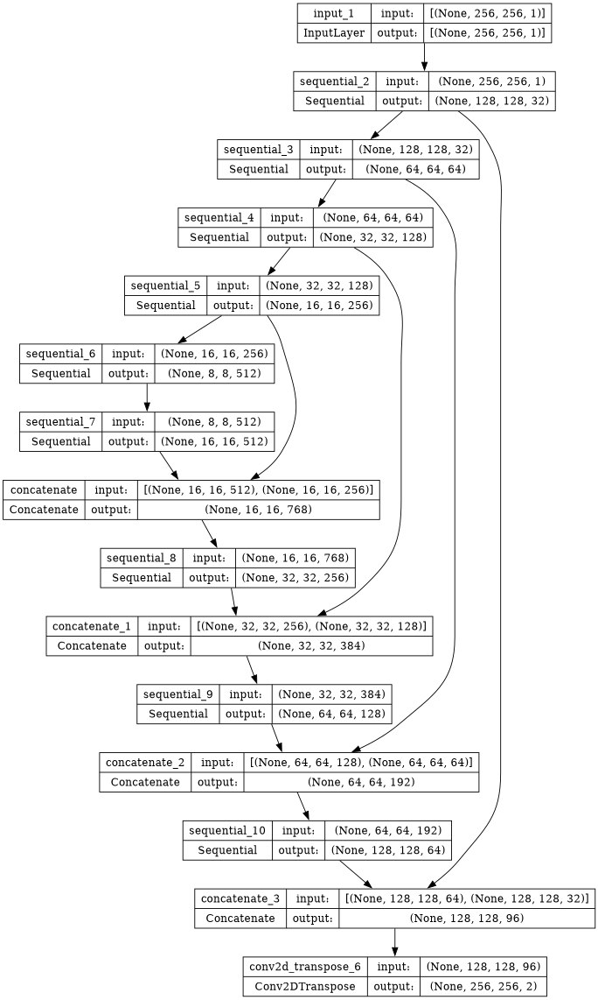

In [26]:
gen = generator()
gen.summary()
plot_model(gen, show_shapes=True, dpi = 64)

In [27]:
# gen.load_weights('/kaggle/input/imagenetmodelweights/gen_weight.keras')

In [28]:
def discriminator():
    init = tf.random_normal_initializer(0., 0.02)

    inp = Input(shape = [IMAGE_SIZE, IMAGE_SIZE, 1], name = "input_image")
    tar = Input(shape = [IMAGE_SIZE, IMAGE_SIZE, 2], name = "target_image")
    x = Concatenate()([inp, tar])
    down1 = downsample(64,4,False)(x)
    down2 = downsample(128, 4)(down1)
    down3 = downsample(256, 4)(down2)

    zero_pad1 = ZeroPadding2D()(down3)
    conv = Conv2D(256, 4, strides = 1, kernel_initializer = init, use_bias = False)(zero_pad1)
    leaky_relu = LeakyReLU()(conv)
    zero_pad2 = ZeroPadding2D()(leaky_relu)
    last = Conv2D(1, 4, strides = 1, kernel_initializer=init)(zero_pad2)
    return Model(inputs = [inp, tar], outputs = last)

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_image (InputLayer)    [(None, 256, 256, 1)]        0         []                            
                                                                                                  
 target_image (InputLayer)   [(None, 256, 256, 2)]        0         []                            
                                                                                                  
 concatenate_4 (Concatenate  (None, 256, 256, 3)          0         ['input_image[0][0]',         
 )                                                                   'target_image[0][0]']        
                                                                                                  
 sequential_12 (Sequential)  (None, 128, 128, 64)         3328      ['concatenate_4[0][0]'] 

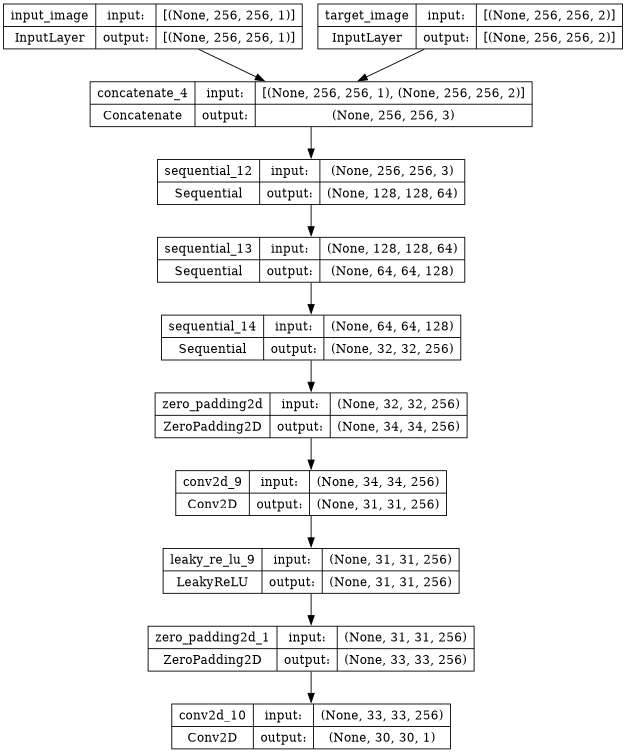

In [29]:
disc = discriminator()
disc.summary()
plot_model(disc, show_shapes=True, dpi = 64)

In [30]:
# disc.load_weights('/kaggle/input/imagenetmodelweights/disc_weight.keras')

In [31]:
# Function to create YUV image from Y, U, and V channels and then convert to rgb
def create_rgb_image(y_channel, uv_channel):
    # Assuming YUV format where Y, U, and V channels are separate
    # y_channel = np.array(y_channel)
    # uv_channel = np.array(uv_channel)
    u_channel, v_channel = tf.split(uv_channel, num_or_size_splits=2, axis=-1)

    # Combine Y, U, and V channels into a YUV image
    rgb_image = tf.image.yuv_to_rgb(tf.concat([y_channel, u_channel, v_channel], axis=-1))
    return rgb_image


In [32]:
LAMBDA = 100

In [33]:
# Define the perceptual loss function
def perceptual_loss(y_true, y_pred):
    vgg = VGG19(include_top=False, weights='imagenet', input_shape=(None, None, 3))
    vgg.trainable = False
    for layer in vgg.layers:
        layer.trainable = False
    model = Model(inputs=vgg.input, outputs=vgg.get_layer('block5_conv4').output)
    model.trainable = False

    y_true_features = model(y_true)
    y_pred_features = model(y_pred)

    return tf.reduce_mean(tf.square(y_true_features - y_pred_features))

In [34]:
def generator_loss(disc_generated_output,input_, gen_output, target):
    gan_loss = loss_function(tf.ones_like(disc_generated_output), disc_generated_output)
    l1_loss = tf.reduce_mean(tf.abs(target - gen_output))
    p_loss = perceptual_loss(create_rgb_image(input_, gen_output), create_rgb_image(input_, target))
    total_gen_loss = gan_loss + (LAMBDA * l1_loss) + 80*p_loss
    return total_gen_loss, gan_loss, l1_loss, p_loss

In [35]:
from keras.losses import BinaryCrossentropy
loss_function = BinaryCrossentropy(from_logits=True)

In [36]:
def discriminator_loss(disc_real_output, disc_generated_output):
    real_loss = loss_function(tf.ones_like(disc_real_output), disc_real_output)
    generated_loss = loss_function(tf.zeros_like(disc_generated_output), disc_generated_output)
    total_disc_loss = real_loss + generated_loss
    return total_disc_loss, real_loss, generated_loss

In [37]:
generator_optimizer = Adam(lr= 2e-4, beta_1=0.5)
discriminator_optimizer = Adam(lr = 2e-4, beta_1=0.5)

In [38]:
epochs = 250

In [39]:
# import tensorflow as tf
# from tensorflow.keras.applications import VGG19
# from tensorflow.keras.models import Model

# # Load the VGG19 model
# vgg = VGG19(weights='imagenet', include_top=False)

# # Select the layers you want to use for the LPIPS score
# selected_layers = ['block1_conv1', 'block2_conv1', 'block3_conv1']

# # Create a model that outputs the selected layers
# outputs = [vgg.get_layer(name).output for name in selected_layers]
# model = Model(inputs=vgg.input, outputs=outputs)

# # Make sure the VGG model is not trainable
# model.trainable = False

# def lpips_score(image1, image2):
#     # Get the features for both images
#     image1_features = model(image1)
#     image2_features = model(image2)

#     # Initialize the score
#     score = 0

#     # For each feature layer...
#     for f1, f2 in zip(image1_features, image2_features):
#         # ... compute the mean squared error between the features
#         mse = tf.reduce_mean((f1 - f2)**2)
#         # ... and add it to the score
#         score += mse

#     return score

In [40]:
# from tensorflow.keras.applications.inception_v3 import InceptionV3
# from scipy.linalg import sqrtm

# # Load the pre-trained InceptionV3 model (weights will be downloaded if not present)
# pretrained_model = InceptionV3(weights='imagenet', include_top=True, pooling='avg')

# # Optionally, you can freeze the layers to prevent training
# for layer in pretrained_model.layers:
#     layer.trainable = False


# # Create a new model to extract features from an intermediate layer
# inception_model = tf.keras.Model(inputs=pretrained_model.input, outputs=pretrained_model.get_layer('avg_pool').input)
# def calculate_fid_score(images1, images2, inception_model):
#     # Ensure the batch dimension is removed for individual image predictions
#     images1 = np.squeeze(images1, axis=0)
#     images2 = np.squeeze(images2, axis=0)
    
#     # Resize images to the required size for the Inception model
#     images1 = tf.image.resize(images1, size=(299, 299))
#     images2 = tf.image.resize(images2, size=(299, 299))
    
#     # Extract features using the Inception model
#     features1 = inception_model.predict(np.expand_dims(images1, axis=0))
#     features2 = inception_model.predict(np.expand_dims(images2, axis=0))

#     # Remove batch dimension from features
#     features1 = np.squeeze(features1, axis=0)
#     features2 = np.squeeze(features2, axis=0)
#     #print(features1.shape)
#     # Calculate mean and covariance of feature representations
#     mean1 = np.mean(features1, axis=(0, 1, 2))
#     mean2 = np.mean(features2, axis=(0, 1, 2))
#     #print(features1.shape)
#     cov1 = np.cov(features1.transpose(2, 0, 1).reshape(features1.shape[-1], -1), rowvar=False)
#     cov2 = np.cov(features2.transpose(2, 0, 1).reshape(features2.shape[-1], -1), rowvar=False)
#     #print(cov2.shape)

#     # Calculate the squared Euclidean distance between means
#     sum_squared_diff = np.sum((mean1 - mean2)**2)

#     # Calculate the trace of the product of covariances
#     cov_sqrt = sqrtm(np.dot(cov1, cov2))
#     trace_cov_product = np.trace(cov1 + cov2 - 2 * cov_sqrt)

#     # Calculate FID score
#     fid_score = np.real(sum_squared_diff + trace_cov_product)
    
#     return fid_score

In [41]:
@tf.function
def train_step(input_image, target, epoch, training_discriminator):
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        gen_output = gen(input_image, training=True)
        disc_real_output = disc([input_image, target], training=True)
        disc_generated_output = disc([input_image, gen_output], training=True)
        gen_total_loss, gen_gan_loss, gen_l1_loss, gen_p_loss = generator_loss(disc_generated_output,input_image, gen_output, target)
        disc_loss, disc_real_loss, disc_generated_loss = discriminator_loss(disc_real_output, disc_generated_output)
#         rgb_target = create_rgb_image(input_image, target)
#         rgb_generated = create_rgb_image(input_image, gen_output)
#         ssim_values = tf.image.ssim(rgb_target, rgb_generated, max_val=1.0)
#         psnr_values = tf.image.psnr(rgb_target, rgb_generated, max_val=1.0)
#         lpips_values = lpips_score(rgb_target, rgb_generated)

        if epoch > 8:
            if training_discriminator:
                discriminator_gradients = disc_tape.gradient(disc_loss, disc.trainable_variables)
                discriminator_optimizer.apply_gradients(zip(discriminator_gradients, disc.trainable_variables))
            else:
                generator_gradients = gen_tape.gradient(gen_total_loss, gen.trainable_variables)
                generator_optimizer.apply_gradients(zip(generator_gradients, gen.trainable_variables))
        else:
            generator_gradients = gen_tape.gradient(gen_total_loss, gen.trainable_variables)
            discriminator_gradients = disc_tape.gradient(disc_loss, disc.trainable_variables)
            generator_optimizer.apply_gradients(zip(generator_gradients, gen.trainable_variables))
            discriminator_optimizer.apply_gradients(zip(discriminator_gradients, disc.trainable_variables))

        return gen_total_loss, gen_gan_loss, gen_l1_loss,gen_p_loss, disc_loss,disc_real_loss, disc_generated_loss, tf.constant([0]), tf.constant([0]), tf.constant([0])

In [42]:
@tf.function
def validation_step(input_image, target):
    # Generate output using the generator
    gen_output = gen(input_image)

    # Calculate losses without updating gradients
    disc_real_output = disc([input_image, target])
    disc_generated_output = disc([input_image, gen_output])

    gen_total_loss, gen_gan_loss, gen_l1_loss, gen_p_loss = generator_loss(disc_generated_output,input_image, gen_output, target)
    disc_loss,disc_real_loss, disc_generated_loss = discriminator_loss(disc_real_output, disc_generated_output)
    rgb_target = create_rgb_image(input_image, target)
    rgb_generated = create_rgb_image(input_image, gen_output)
    ssim_values = tf.image.ssim(rgb_target, rgb_generated, max_val=1.0)
    psnr_values = tf.image.psnr(rgb_target, rgb_generated, max_val=1.0)
#     lpips_values = lpips_score(rgb_target, rgb_generated)
    #accuracy = calculate_accuracy(disc_generated_output, disc_real_output)
    return gen_total_loss, gen_gan_loss, gen_l1_loss,gen_p_loss, disc_loss,disc_real_loss, disc_generated_loss, ssim_values, tf.constant([0]), tf.constant([0])

In [43]:
# @tf.function
# def test_step(input_image, target):
#     # Generate output using the generator
#     gen_output = gen(input_image)

#     # Calculate losses without updating gradients
#     disc_real_output = disc([input_image, target])
#     disc_generated_output = disc([input_image, gen_output])

#     gen_total_loss, gen_gan_loss, gen_l1_loss, gen_p_loss = generator_loss(disc_generated_output,input_image, gen_output, target)
#     disc_loss,disc_real_loss, disc_generated_loss = discriminator_loss(disc_real_output, disc_generated_output)
#     rgb_target = create_rgb_image(input_image, target)
#     rgb_generated = create_rgb_image(input_image, gen_output)
#     ssim_values = tf.image.ssim(rgb_target, rgb_generated, max_val=1.0)
#     psnr_values = tf.image.psnr(rgb_target, rgb_generated, max_val=1.0)
#     lpips_values = lpips_score(rgb_target, rgb_generated)
#     fid_values = calculate_fid_score(rgb_target, rgb_generated, inception_model)
#     #accuracy = calculate_accuracy(disc_generated_output, disc_real_output)
#     return gen_total_loss, gen_gan_loss, gen_l1_loss,gen_p_loss, disc_loss,disc_real_loss, disc_generated_loss, ssim_values, psnr_values, lpips_values, fid_values


In [44]:
os.mkdir('/kaggle/working/gen_output/')

In [45]:
def display_one_random_test_image(input_, target, gen_model, epoch):
    print("Displaying one random test image...")
    img_array = np.array(input_)
    generated_output_test = gen_model(input_)
    ssim = tf.image.ssim(tf.reshape(create_rgb_image(input_, target), (256,256,3)), tf.reshape(create_rgb_image(input_,generated_output_test), (256,256,3)), max_val=1.0)
    psnr = tf.image.psnr(tf.reshape(create_rgb_image(input_, target), (256,256,3)), tf.reshape(create_rgb_image(input_,generated_output_test), (256,256,3)), max_val=1.0)  
#     lpips = lpips_score(tf.reshape(create_rgb_image(input_, target), (1,256,256,3)), tf.reshape(create_rgb_image(input_,generated_output_test), (1,256,256,3)))
#     p_loss = perceptual_loss(create_rgb_image(input_, target), create_rgb_image(input_, generated_output_test))
#     fid_score = calculate_fid_score(tf.reshape(create_rgb_image(input_, target), (1,256,256,3)), tf.reshape(create_rgb_image(input_,generated_output_test), (1,256,256,3)), inception_model)
    # print(input_.shape)
    input_ = np.squeeze(input_, axis=0)
    # print(type(input_), type(target))
    # print(input_.shape, input_)
    # input_.reshape((256,256))
    plt.figure(figsize=(16, 16))
    plt.subplot(1, 4, 1)
    plt.title('Input Testing Image')
    plt.imshow(input_, cmap='gray', vmax = 1, vmin = 0)  # Assuming images are normalized to [0, 1]
    plt.axis('off')
    # # print(target.shape)
    target = np.squeeze(target, axis=0)
    # # print(target.shape)
    target_img = create_rgb_image(input_, target).numpy()
    # # print(type(target_img))
    # target
    # # print(target_img.shape, target_img)
    plt.subplot(1, 4, 2)
    plt.title('Target Testing Image')
    plt.imshow(target_img)  # Assuming images are normalized to [0, 1]
    plt.axis('off')
    # # Convert PIL Image to NumPy array
    # img_array = np.array(input_)
    # # Add batch dimension
    # # print(img_array.shape)
    # img_array = np.expand_dims(img_array, axis=0)
    # # print(img_array.shape)
    # generated_output_test = gen_model(img_array)
    # # print(generated_output_test.shape)
    # # Squeeze the singleton dimension
    generated_output_test = np.squeeze(generated_output_test, axis=0)
    # # print(generated_output_test.shape)
    generated_img = create_rgb_image(input_, generated_output_test).numpy()
    # # print(generated_img.shape, generated_img)
    plt.subplot(1, 4, 3)
    plt.title(f'Generated Output -- epoch {epoch}')
    plt.imshow(generated_img)  # Assuming images are normalized to [-1, 1]
    plt.axis('off')
    plt.savefig(f'/kaggle/working/gen_output/epoch_{epoch}.png')
    plt.show()
    print('SSIM Score: {}'.format(ssim))
    print('PSNR Score: {}'.format(psnr))
#     print('LPIPS Score: {}'.format(lpips))
#     print('Perceptual Loss: {}'.format(p_loss))
#     print('FID Score: {}'.format(fid_score))

In [46]:
def display_random_test_image(gen_model, image_path, epoch):
    
    real_image = load(image_path)
    real_image = resize(real_image)
    real_image = normalize(real_image)
    yuv_image = tf.image.rgb_to_yuv(real_image)
    # Separate LAB into L and AB components
    Y_channel = tf.expand_dims(yuv_image[:, :, 0], axis=-1)  # L channel
    UV_channels = yuv_image[:, :, 1:] 

    # Display the image
    display_one_random_test_image(tf.reshape(Y_channel, (1,256,256,1)),tf.reshape(UV_channels,(1,256,256,2)), gen_model, epoch)


Displaying one random test image...


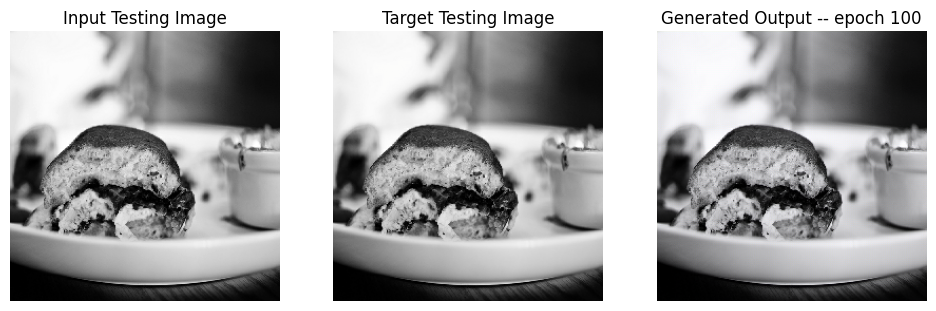

SSIM Score: 0.9751405119895935
PSNR Score: 41.326576232910156


In [47]:
display_random_test_image(gen, '/kaggle/input/coco2017/val2017/val2017/000000001425.jpg',100)

In [48]:
import random

each_epoch_train_generator_losses = []
each_epoch_train_generator_gan_losses = []
each_epoch_train_generator_l1_losses = []
each_epoch_train_generator_l2_losses = []
each_epoch_train_generator_perceptual_losses = []
each_epoch_train_discriminator_losses = []
each_epoch_train_discriminator_real_losses = []
each_epoch_train_discriminator_generated_losses = []
each_epoch_train_ssim = []
each_epoch_train_psnr = []
each_epoch_train_lpips = []
each_epoch_test_lpips = []
each_epoch_test_psnr = []
each_epoch_test_ssim = []
each_epoch_test_generator_losses = []
each_epoch_test_generator_gan_losses = []
each_epoch_test_generator_l1_losses = []
each_epoch_test_generator_l2_losses = []
each_epoch_test_generator_perceptual_losses = []
each_epoch_test_discriminator_losses = []
each_epoch_test_discriminator_real_losses = []
each_epoch_test_discriminator_generated_losses = []
train_generator_losses = []
train_generator_gan_losses = []
train_generator_l1_losses = []
train_generator_l2_losses = []
train_generator_perceptual_losses = []
train_discriminator_losses = []
train_discriminator_real_losses = []
train_discriminator_generated_losses = []
test_generator_losses = []
test_generator_gan_losses = []
test_generator_l1_losses = []
test_generator_l2_losses = []
test_generator_perceptual_losses = []
test_discriminator_losses = []
test_discriminator_real_losses = []
test_discriminator_generated_losses =[]
training_ssim = []
training_psnr = []
training_lpips = []
testing_ssim = []
testing_psnr = []
testing_lpips = []
each_epoch_all_records = []
all_records = []
def fit(train_ds, epochs, test_ds, gen_model):

    # Declare global lists
    global each_epoch_train_generator_losses, each_epoch_train_generator_gan_losses, each_epoch_train_generator_l1_losses, each_epoch_train_generator_l2_losses, each_epoch_train_generator_perceptual_losses, each_epoch_train_discriminator_losses,each_epoch_train_discriminator_real_losses, each_epoch_train_discriminator_generated_losses, each_epoch_train_ssim, each_epoch_train_psnr
    global each_epoch_test_psnr, each_epoch_test_ssim, each_epoch_test_generator_losses, each_epoch_test_generator_gan_losses, each_epoch_test_generator_l1_losses, each_epoch_test_generator_l2_losses, each_epoch_test_generator_perceptual_losses, each_epoch_test_discriminator_losses, each_epoch_test_discriminator_real_losses, each_epoch_test_discriminator_generated_losses
    global train_generator_losses, train_generator_gan_losses, train_generator_l1_losses, train_generator_l2_losses, train_generator_perceptual_losses, train_discriminator_losses, train_discriminator_real_losses, train_discriminator_generated_losses, test_generator_losses, test_generator_l2_losses, test_generator_gan_losses, test_generator_l1_losses, test_generator_perceptual_losses, test_discriminator_losses, test_discriminator_real_losses, test_discriminator_generated_losses
    global training_ssim, training_psnr, testing_ssim, testing_psnr, each_epoch_all_records, all_records, LAMBDA, each_epoch_train_lpips, each_epoch_test_lpips, training_lpips, testing_lpips


    # Initialize counters and flags
    consecutive_epochs_high_loss = 0
    training_discriminator = True
    stop_training = False
    min_learning_rate = 1e-7  # Set your desired minimum learning rate
    time_start = time.time()
    
    for ep in range(epochs):
        epoch = ep 
        start = time.time()
        train_count = 0
        test_count = 0

        print(f"Epoch {epoch}")

        for n, (input_, target) in train_ds.enumerate():
            if epoch > 10:
                train_gen_loss, train_gen_gan_loss, train_gen_l1_loss,train_gen_perceptual_loss, train_disc_loss, train_disc_real_loss, train_disc_generated_loss, train_ssim, train_psnr, train_lpips = train_step(input_, target, epoch, training_discriminator=training_discriminator)

            else:
                # If epoch is less than or equal to 10, train both generator and discriminator
                train_gen_loss, train_gen_gan_loss, train_gen_l1_loss, train_gen_perceptual_loss, train_disc_loss, train_disc_real_loss, train_disc_generated_loss, train_ssim, train_psnr, train_lpips  = train_step(input_, target, epoch, training_discriminator=None)

            each_epoch_train_generator_losses.append(train_gen_loss)
            each_epoch_train_generator_gan_losses.append(train_gen_gan_loss)
            each_epoch_train_generator_l1_losses.append(train_gen_l1_loss)
#             each_epoch_train_generator_l2_losses.append(train_gen_l2_loss)
            each_epoch_train_generator_perceptual_losses.append(train_gen_perceptual_loss)
            each_epoch_train_discriminator_losses.append(train_disc_loss)
            each_epoch_train_discriminator_real_losses.append(train_disc_real_loss)
            each_epoch_train_discriminator_generated_losses.append(train_disc_generated_loss)
            each_epoch_train_ssim.append(tf.reduce_mean(train_ssim.numpy()))
            each_epoch_train_psnr.append(tf.reduce_mean(train_psnr.numpy()))
            each_epoch_train_lpips.append(tf.reduce_mean(train_lpips.numpy()))
#             print(train_count)
            train_count += 1
#             print(n)
        #each_epoch_train_generator_losses = np.array(each_epoch_train_generator_losses)
        #print(each_epoch_train_discriminator_losses.shape())
        #print(each_epoch_train_generator_losses.shape())
        #print(each_epoch_train_ssim())
        print("Training Details")
        print("Generator-- total_loss:{:.5f} gan_loss:{:.5f} l1_loss:{:.5f} perceptual_loss:{:.5f} Discriminator-- total_loss:{:.5f} real_loss:{:.5f} generated_loss:{:.5f} --- SSIM {:.5f} PSNR {:.5f} LPIPS {:.5f}".format(np.mean(each_epoch_train_generator_losses),np.mean(each_epoch_train_generator_gan_losses), np.mean(each_epoch_train_generator_l1_losses),np.mean(each_epoch_train_generator_perceptual_losses), np.mean(each_epoch_train_discriminator_losses), np.mean(each_epoch_train_discriminator_generated_losses), np.mean(each_epoch_train_discriminator_real_losses), np.mean(each_epoch_train_ssim), np.mean(each_epoch_train_psnr), np.mean(each_epoch_train_lpips)))
        print("Time taken for epoch {} is {} sec".format(epoch + 1, time.time() - start))
        print(f"Number of iteration {train_count}")

        train_generator_losses.append(np.mean(each_epoch_train_generator_losses))
        train_generator_gan_losses.append(np.mean(each_epoch_train_generator_gan_losses))
        train_generator_l1_losses.append(np.mean(each_epoch_train_generator_l1_losses))
#         train_generator_l2_losses.append(np.mean(each_epoch_train_generator_l2_losses))
        train_generator_perceptual_losses.append(np.mean(each_epoch_train_generator_perceptual_losses))
        train_discriminator_losses.append(np.mean(each_epoch_train_discriminator_losses))
        train_discriminator_real_losses.append(np.mean(each_epoch_train_discriminator_real_losses))
        train_discriminator_generated_losses.append(np.mean(each_epoch_train_discriminator_generated_losses))
        training_ssim.append(np.mean(each_epoch_train_ssim))
        training_psnr.append(np.mean(each_epoch_train_psnr))
        training_lpips.append(np.mean(each_epoch_train_lpips))

        # Test
        for n, (input_, target) in test_ds.enumerate():
            test_gen_loss, test_gen_gan_loss, test_gen_l1_loss, test_gen_perceptual_loss, test_disc_loss, test_disc_real_loss, test_disc_generated_loss, test_ssim, test_psnr, test_lpips = validation_step(input_, target)
            test_count += 1

            each_epoch_test_generator_losses.append(test_gen_loss)
            each_epoch_test_generator_gan_losses.append(test_gen_gan_loss)
            each_epoch_test_generator_l1_losses.append(test_gen_l1_loss)
#             each_epoch_test_generator_l2_losses.append(test_gen_l2_loss)
            each_epoch_test_generator_perceptual_losses.append(test_gen_perceptual_loss)
            each_epoch_test_discriminator_losses.append(test_disc_loss)
            each_epoch_test_discriminator_real_losses.append(test_disc_real_loss)
            each_epoch_test_discriminator_generated_losses.append(test_disc_generated_loss)
            each_epoch_test_ssim.append(tf.reduce_mean(test_ssim.numpy()))
            each_epoch_test_psnr.append(tf.reduce_mean(test_psnr.numpy()))
            each_epoch_test_lpips.append(tf.reduce_mean(test_lpips.numpy()))
    
        print("Validation Details")
        print("Generator-- total_loss:{:.5f} gan_loss:{:.5f} l1_loss:{:.5f}  perceptual_loss:{:.5f} Discriminator-- total_loss:{:.5f} real_loss:{:.5f} generated_loss:{:.5f} --- SSIM {:.5f} PSNR {:.5f} LPIPS {:.5f}".format(np.mean(each_epoch_test_generator_losses),np.mean(each_epoch_test_generator_gan_losses), np.mean(each_epoch_test_generator_l1_losses), np.mean(each_epoch_test_generator_perceptual_losses),np.mean(each_epoch_test_discriminator_losses), np.mean(each_epoch_test_discriminator_generated_losses), np.mean(each_epoch_test_discriminator_real_losses), np.mean(each_epoch_test_ssim), np.mean(each_epoch_test_psnr), np.mean(each_epoch_test_lpips)))
        print("Time taken for epoch {} is {} sec".format(epoch+1, time.time() - start))
        print(f"Number of iteration {test_count}")
#         LAMBDA = LAMBDA * 1.006
        test_generator_losses.append(np.mean(each_epoch_test_generator_losses))
        test_generator_gan_losses.append(np.mean(each_epoch_test_generator_gan_losses))
        test_generator_l1_losses.append(np.mean(each_epoch_test_generator_l1_losses))
#         test_generator_l2_losses.append(np.mean(each_epoch_test_generator_l2_losses))
        test_generator_perceptual_losses.append(np.mean(each_epoch_test_generator_perceptual_losses))
        test_discriminator_losses.append(np.mean(each_epoch_test_discriminator_losses))
        test_discriminator_real_losses.append(np.mean(each_epoch_test_discriminator_real_losses))
        test_discriminator_generated_losses.append(np.mean(each_epoch_test_discriminator_generated_losses))
        testing_ssim.append(np.mean(each_epoch_test_ssim))
        testing_psnr.append(np.mean(each_epoch_test_psnr))
        testing_lpips.append(np.mean(each_epoch_test_lpips))

        each_epoch_all_records.append([np.mean(each_epoch_train_generator_losses),np.mean(each_epoch_train_generator_gan_losses), np.mean(each_epoch_train_generator_l1_losses),np.mean(each_epoch_train_generator_perceptual_losses), np.mean(each_epoch_train_discriminator_losses), np.mean(each_epoch_train_discriminator_generated_losses), np.mean(each_epoch_train_discriminator_real_losses), np.mean(each_epoch_train_ssim), np.mean(each_epoch_train_psnr), np.mean(each_epoch_test_generator_losses),np.mean(each_epoch_test_generator_gan_losses), np.mean(each_epoch_test_generator_l1_losses),np.mean(each_epoch_test_generator_perceptual_losses),np.mean(each_epoch_test_discriminator_losses), np.mean(each_epoch_test_discriminator_generated_losses), np.mean(each_epoch_test_discriminator_real_losses), np.mean(each_epoch_test_ssim), np.mean(each_epoch_test_psnr)])
        all_records.append(each_epoch_all_records)
        # emptying for next epoch
        each_epoch_test_ssim = []
        each_epoch_test_generator_losses = []
        each_epoch_test_generator_gan_losses = []
        each_epoch_test_generator_l1_losses = []
#         each_epoch_test_generator_l2_losses = []
        each_epoch_test_generator_perceptual_losses = []
        each_epoch_test_discriminator_losses = []
        each_epoch_test_discriminator_real_losses = []
        each_epoch_test_discriminator_generated_losses = []
        each_epoch_test_psnr = []
        each_epoch_test_lpips = []
        each_epoch_all_records = []
        #emptyling list for next iteration
        each_epoch_train_generator_losses = []
        each_epoch_train_generator_gan_losses = []
        each_epoch_train_generator_l1_losses = []
#         each_epoch_train_generator_l2_losses = []
        each_epoch_train_generator_perceptual_losses = []
        each_epoch_train_discriminator_losses = []
        each_epoch_train_discriminator_real_losses = []
        each_epoch_train_discriminator_generated_losses = []
        each_epoch_train_ssim = []
        each_epoch_train_psnr = []
        each_epoch_train_lpips = []
        if time.time() - time_start > 41000:
            stop_training = True
        if epoch == 0 or epoch % 3 == 0:
            # Function to display one random test image
            # def display_random_test_image(images, labels, gen_model):
            #     # Randomly select an index
            #     random_test_image_idx = random.randint(0, len(images) - 1)

            #     # Extract input and target from the selected index
            #     random_test_input = images[random_test_image_idx]
            #     random_test_target = labels[random_test_image_idx]

            #     # Display the image
            #     display_one_random_test_image(random_test_input, random_test_target, gen_model)

            # Example usage
            display_random_test_image(gen, '/kaggle/input/coco2017/val2017/val2017/000000001425.jpg', epoch+1)
        # Check if the difference between two consecutive epochs for the last 5 epochs is less than 1
        if ep > 10:
            # Check 1f the difference between two consecutive epochs for the last S epochs is less than 1 or 0.3
            last_epochs_losses = train_discriminator_losses[-5:] if training_discriminator else train_generator_losses[-5:]
            if all(((last_epochs_losses[i] - last_epochs_losses[i - 1])) < 0.01 if training_discriminator else ((last_epochs_losses[1] - last_epochs_losses[i - 1])) < 0.05 for i in range(1, 5)):
                consecutive_epochs_high_loss += 1
            else:
                consecutive_epochs_high_loss = 0
        
        
#         LAMBDA = LAMBDA*1.003
            # If the condition is met for 4 consecutive epochs, reduce the learning rate
        if consecutive_epochs_high_loss == 4:
            if training_discriminator:
                current_lr = generator_optimizer. learning_rate.numpy()
                new_lr = max (current_lr * 0.45, min_learning_rate)
                if new_lr > min_learning_rate:
                    generator_optimizer.learning_rate.assign(new_lr)
                    print (f"Reduced generator learning rate to {new_lr} at epoch {epoch + 1}")
                    # Switch training focus
                    training_discriminator = not training_discriminator
                else:
                    print(f"Generator learning rate already at the minimum. Stopping training.")
                    stop_training = True
            else:
                current_lr = discriminator_optimizer.learning_rate.numpy()
                new_lr = max (current_lr * 0.3, min_learning_rate)
                if new_lr > min_learning_rate:
                    discriminator_optimizer.learning_rate.assign(new_lr)
                    print(f"Reduced discriminator learning rate to {new_lr} at epoch {epoch + 1}.")
                    # Switch training focus
                    training_discriminator = not training_discriminator
                else:
                    print(f"Discriminator learning rate already at the minimum. Stopping training.")
                    stop_training = True

                consecutive_epochs_high_loss = 0
        # Check the flag variable
        if stop_training:
            break

In [49]:
tf.config.run_functions_eagerly(True)

Epoch 0
80134624/80134624 [==============================] - 0s 0us/step
Training Details
Generator-- total_loss:7.51585 gan_loss:1.29564 l1_loss:0.05298 perceptual_loss:0.01152 Discriminator-- total_loss:1.32116 real_loss:0.65287 generated_loss:0.66829 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 1 is 311.28478813171387 sec
Number of iteration 250
Validation Details
Generator-- total_loss:11.67100 gan_loss:0.32345 l1_loss:0.10155  perceptual_loss:0.01490 Discriminator-- total_loss:1.70983 real_loss:1.39987 generated_loss:0.30996 --- SSIM 0.67347 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 1 is 333.5641210079193 sec
Number of iteration 32
Displaying one random test image...


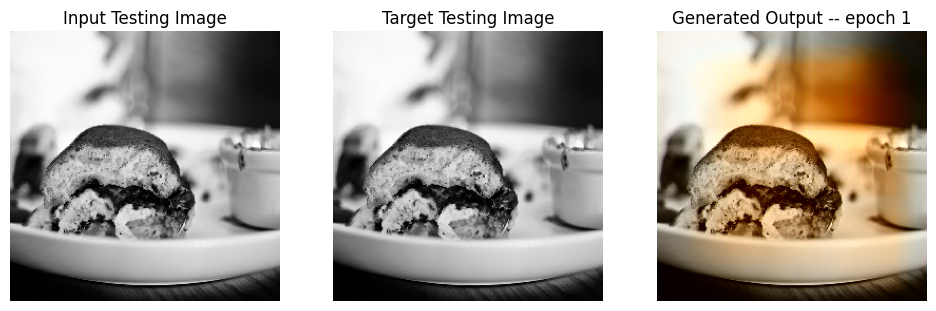

SSIM Score: 0.7592527866363525
PSNR Score: 17.072132110595703
Epoch 1
Training Details
Generator-- total_loss:7.05502 gan_loss:1.14382 l1_loss:0.05084 perceptual_loss:0.01034 Discriminator-- total_loss:1.26761 real_loss:0.62640 generated_loss:0.64121 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 2 is 303.4002935886383 sec
Number of iteration 250
Validation Details
Generator-- total_loss:17.60519 gan_loss:0.14046 l1_loss:0.16048  perceptual_loss:0.01770 Discriminator-- total_loss:4.45204 real_loss:4.11119 generated_loss:0.34085 --- SSIM 0.61515 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 2 is 324.9847414493561 sec
Number of iteration 32
Epoch 2
Training Details
Generator-- total_loss:7.37390 gan_loss:1.29467 l1_loss:0.05255 perceptual_loss:0.01031 Discriminator-- total_loss:1.24506 real_loss:0.61342 generated_loss:0.63164 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 3 is 295.8092710971832 sec
Number of iteration 250
Validation Details
Generator

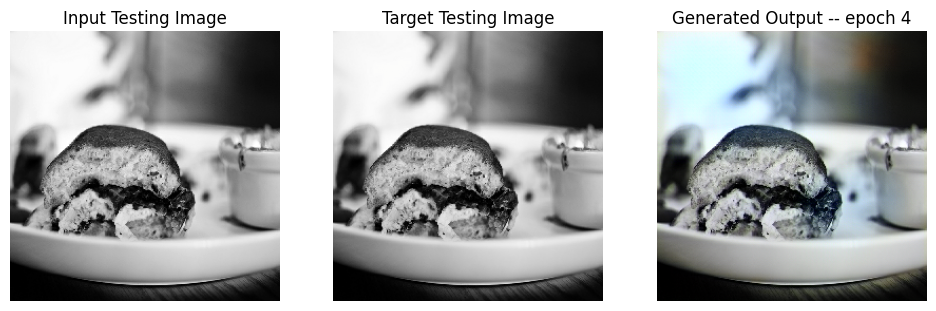

SSIM Score: 0.9617395997047424
PSNR Score: 26.702062606811523
Epoch 4
Training Details
Generator-- total_loss:7.08048 gan_loss:1.08184 l1_loss:0.05190 perceptual_loss:0.01011 Discriminator-- total_loss:1.24809 real_loss:0.61033 generated_loss:0.63776 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 5 is 299.77544474601746 sec
Number of iteration 250
Validation Details
Generator-- total_loss:6.61062 gan_loss:0.47041 l1_loss:0.05173  perceptual_loss:0.01209 Discriminator-- total_loss:1.42505 real_loss:1.01844 generated_loss:0.40662 --- SSIM 0.85759 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 5 is 321.23819875717163 sec
Number of iteration 32
Epoch 5
Training Details
Generator-- total_loss:6.85242 gan_loss:1.04478 l1_loss:0.05016 perceptual_loss:0.00989 Discriminator-- total_loss:1.26938 real_loss:0.62206 generated_loss:0.64731 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 6 is 303.565548658371 sec
Number of iteration 250
Validation Details
Generator

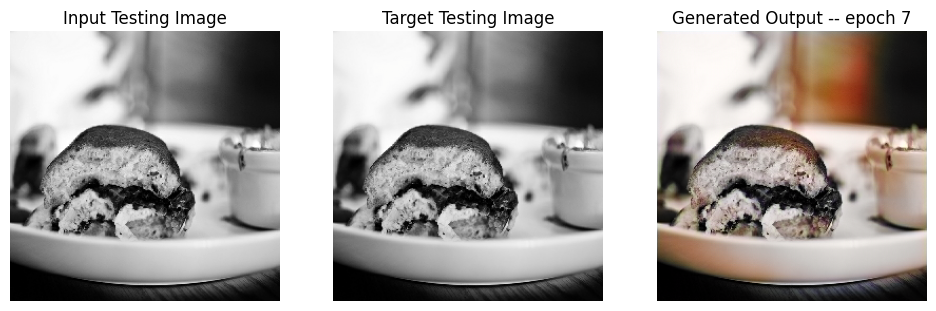

SSIM Score: 0.9707855582237244
PSNR Score: 24.05419158935547
Epoch 7
Training Details
Generator-- total_loss:6.86996 gan_loss:1.06603 l1_loss:0.05009 perceptual_loss:0.00994 Discriminator-- total_loss:1.22889 real_loss:0.59359 generated_loss:0.63530 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 8 is 305.0975384712219 sec
Number of iteration 250
Validation Details
Generator-- total_loss:26.03546 gan_loss:1.21180 l1_loss:0.23406  perceptual_loss:0.01772 Discriminator-- total_loss:1.23183 real_loss:0.58261 generated_loss:0.64922 --- SSIM 0.54087 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 8 is 326.94465041160583 sec
Number of iteration 32
Epoch 8
Training Details
Generator-- total_loss:6.81825 gan_loss:1.05332 l1_loss:0.04962 perceptual_loss:0.01004 Discriminator-- total_loss:1.23370 real_loss:0.60723 generated_loss:0.62647 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 9 is 303.9908549785614 sec
Number of iteration 250
Validation Details
Generator

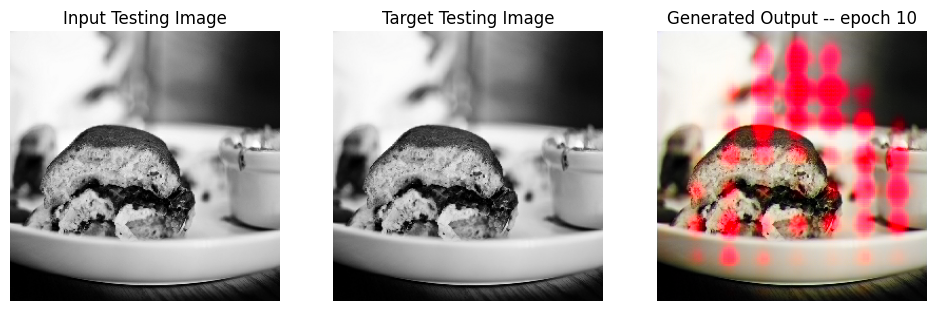

SSIM Score: 0.7684188485145569
PSNR Score: 12.621760368347168
Epoch 10
Training Details
Generator-- total_loss:5.92770 gan_loss:0.62569 l1_loss:0.04492 perceptual_loss:0.01013 Discriminator-- total_loss:1.53729 real_loss:0.94456 generated_loss:0.59274 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 11 is 272.2178087234497 sec
Number of iteration 250
Validation Details
Generator-- total_loss:7.80486 gan_loss:0.89220 l1_loss:0.05919  perceptual_loss:0.01242 Discriminator-- total_loss:1.42482 real_loss:0.76219 generated_loss:0.66263 --- SSIM 0.88601 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 11 is 293.69485545158386 sec
Number of iteration 32
Epoch 11
Training Details
Generator-- total_loss:11.90024 gan_loss:6.74861 l1_loss:0.04361 perceptual_loss:0.00989 Discriminator-- total_loss:0.09771 real_loss:0.05670 generated_loss:0.04101 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 12 is 206.98198127746582 sec
Number of iteration 250
Validation Details
Ge

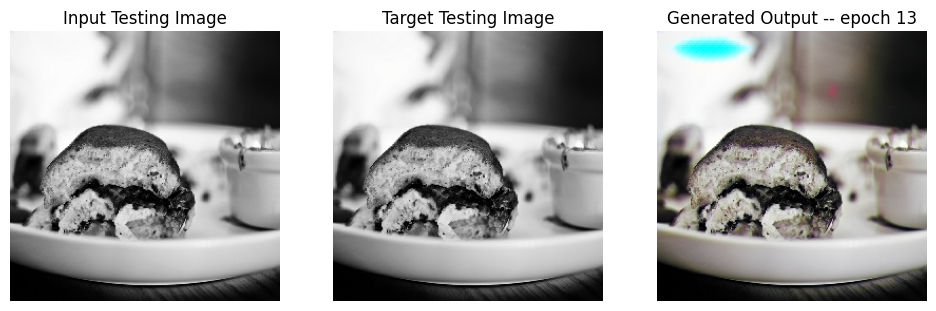

SSIM Score: 0.9657989144325256
PSNR Score: 20.919095993041992
Epoch 13
Training Details
Generator-- total_loss:15.26768 gan_loss:10.13403 l1_loss:0.04335 perceptual_loss:0.00998 Discriminator-- total_loss:0.00194 real_loss:0.00116 generated_loss:0.00078 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 14 is 207.6357192993164 sec
Number of iteration 250
Validation Details
Generator-- total_loss:6.79617 gan_loss:0.53832 l1_loss:0.05313  perceptual_loss:0.01181 Discriminator-- total_loss:3.37872 real_loss:2.99673 generated_loss:0.38200 --- SSIM 0.89782 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 14 is 229.23687171936035 sec
Number of iteration 32
Epoch 14
Training Details
Generator-- total_loss:16.13412 gan_loss:11.08240 l1_loss:0.04257 perceptual_loss:0.00994 Discriminator-- total_loss:0.00038 real_loss:0.00018 generated_loss:0.00021 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 15 is 209.51527976989746 sec
Number of iteration 250
Validation Details

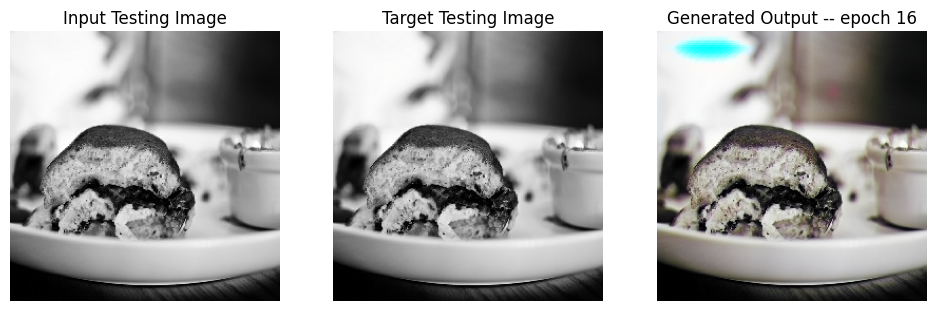

SSIM Score: 0.9674881100654602
PSNR Score: 21.54056167602539
Epoch 16
Training Details
Generator-- total_loss:17.33509 gan_loss:12.22771 l1_loss:0.04315 perceptual_loss:0.00991 Discriminator-- total_loss:0.00017 real_loss:0.00008 generated_loss:0.00009 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 17 is 201.72395992279053 sec
Number of iteration 250
Validation Details
Generator-- total_loss:6.51771 gan_loss:0.20738 l1_loss:0.05398  perceptual_loss:0.01141 Discriminator-- total_loss:4.03065 real_loss:3.86349 generated_loss:0.16716 --- SSIM 0.89406 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 17 is 222.77578854560852 sec
Number of iteration 32
Epoch 17
Training Details
Generator-- total_loss:17.73648 gan_loss:12.55788 l1_loss:0.04376 perceptual_loss:0.01003 Discriminator-- total_loss:1.31853 real_loss:0.39027 generated_loss:0.92826 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 18 is 195.10381984710693 sec
Number of iteration 250
Validation Details

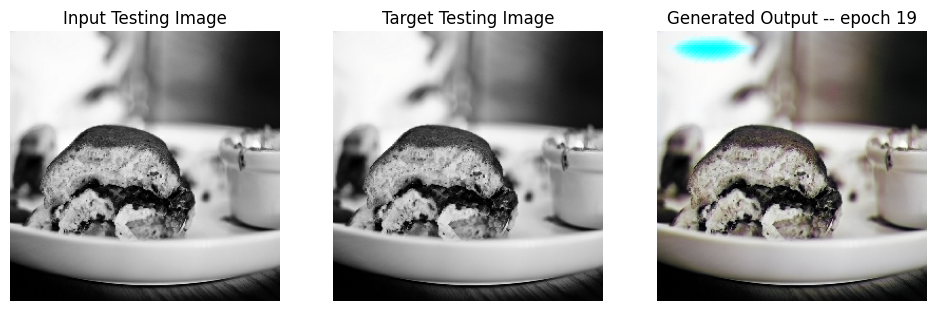

SSIM Score: 0.96639084815979
PSNR Score: 20.786537170410156
Epoch 19
Training Details
Generator-- total_loss:16.28093 gan_loss:11.14998 l1_loss:0.04346 perceptual_loss:0.00981 Discriminator-- total_loss:0.01706 real_loss:0.01016 generated_loss:0.00691 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 20 is 195.37241101264954 sec
Number of iteration 250
Validation Details
Generator-- total_loss:8.43413 gan_loss:2.17006 l1_loss:0.05344  perceptual_loss:0.01150 Discriminator-- total_loss:1.52682 real_loss:0.39049 generated_loss:1.13633 --- SSIM 0.89985 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 20 is 216.3245072364807 sec
Number of iteration 32
Epoch 20
Training Details
Generator-- total_loss:16.96604 gan_loss:11.94195 l1_loss:0.04237 perceptual_loss:0.00984 Discriminator-- total_loss:0.00376 real_loss:0.00231 generated_loss:0.00145 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 21 is 194.76544785499573 sec
Number of iteration 250
Validation Details
G

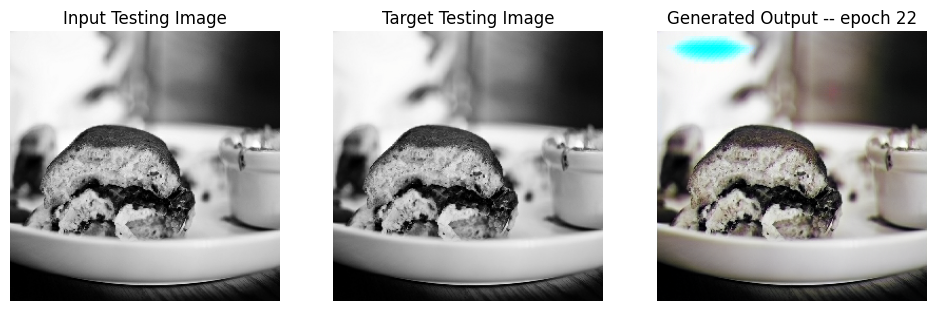

SSIM Score: 0.9655407071113586
PSNR Score: 20.49078369140625
Epoch 22
Training Details
Generator-- total_loss:19.07954 gan_loss:14.06259 l1_loss:0.04218 perceptual_loss:0.00999 Discriminator-- total_loss:0.00106 real_loss:0.00034 generated_loss:0.00072 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 23 is 194.90628218650818 sec
Number of iteration 250
Validation Details
Generator-- total_loss:8.59116 gan_loss:2.30213 l1_loss:0.05329  perceptual_loss:0.01200 Discriminator-- total_loss:1.16232 real_loss:0.31421 generated_loss:0.84811 --- SSIM 0.89758 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 23 is 215.79826879501343 sec
Number of iteration 32
Epoch 23
Training Details
Generator-- total_loss:19.35152 gan_loss:14.23969 l1_loss:0.04311 perceptual_loss:0.01001 Discriminator-- total_loss:0.00304 real_loss:0.00169 generated_loss:0.00135 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 24 is 194.3855037689209 sec
Number of iteration 250
Validation Details


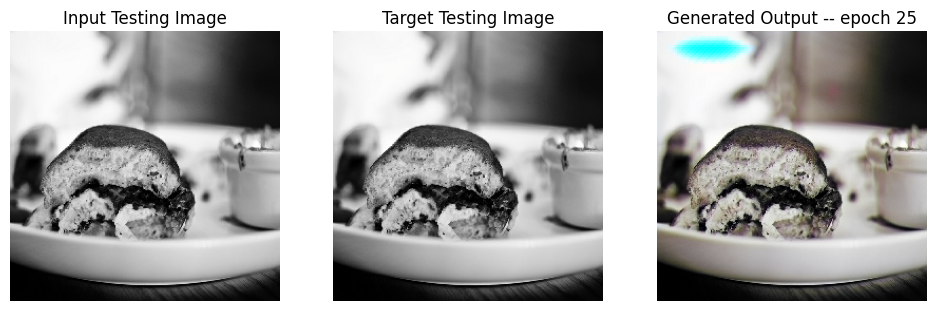

SSIM Score: 0.9665600657463074
PSNR Score: 20.9730224609375
Reduced generator learning rate to 0.0004500000213738531 at epoch 25
Epoch 25
Training Details
Generator-- total_loss:4.97229 gan_loss:0.08069 l1_loss:0.04179 perceptual_loss:0.00890 Discriminator-- total_loss:14.39127 real_loss:14.39118 generated_loss:0.00008 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 26 is 258.5173771381378 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.50929 gan_loss:0.00002 l1_loss:0.04753  perceptual_loss:0.00945 Discriminator-- total_loss:16.69393 real_loss:16.69388 generated_loss:0.00005 --- SSIM 0.91447 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 26 is 279.6178719997406 sec
Number of iteration 32
Epoch 26
Training Details
Generator-- total_loss:4.80869 gan_loss:0.01564 l1_loss:0.04087 perceptual_loss:0.00882 Discriminator-- total_loss:13.96317 real_loss:13.96297 generated_loss:0.00020 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 27 

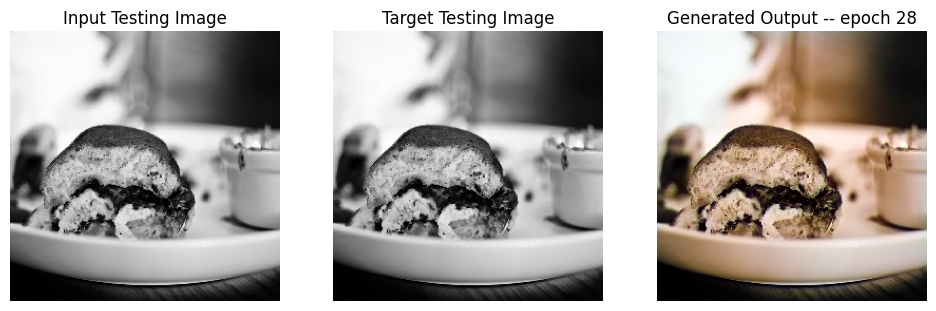

SSIM Score: 0.9666018486022949
PSNR Score: 22.41181182861328
Epoch 28
Training Details
Generator-- total_loss:4.68623 gan_loss:0.01413 l1_loss:0.03974 perceptual_loss:0.00872 Discriminator-- total_loss:13.17838 real_loss:13.17822 generated_loss:0.00016 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 29 is 259.88119649887085 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.21806 gan_loss:0.00001 l1_loss:0.04388  perceptual_loss:0.01038 Discriminator-- total_loss:18.96655 real_loss:18.96651 generated_loss:0.00004 --- SSIM 0.91948 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 29 is 281.49304699897766 sec
Number of iteration 32
Epoch 29
Training Details
Generator-- total_loss:4.78338 gan_loss:0.01326 l1_loss:0.04068 perceptual_loss:0.00878 Discriminator-- total_loss:12.91386 real_loss:12.91370 generated_loss:0.00015 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 30 is 264.31853461265564 sec
Number of iteration 250
Validation Detai

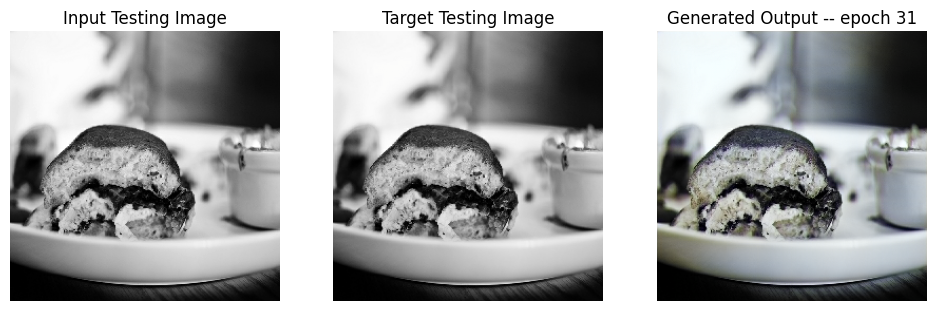

SSIM Score: 0.9929949641227722
PSNR Score: 33.552452087402344
Epoch 31
Training Details
Generator-- total_loss:4.75767 gan_loss:0.01382 l1_loss:0.04045 perceptual_loss:0.00874 Discriminator-- total_loss:12.97169 real_loss:12.97150 generated_loss:0.00020 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 32 is 259.7253019809723 sec
Number of iteration 250
Validation Details
Generator-- total_loss:7.99524 gan_loss:0.00005 l1_loss:0.07159  perceptual_loss:0.01045 Discriminator-- total_loss:13.93109 real_loss:13.93078 generated_loss:0.00031 --- SSIM 0.89155 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 32 is 281.2203938961029 sec
Number of iteration 32
Epoch 32
Training Details
Generator-- total_loss:4.75775 gan_loss:0.01418 l1_loss:0.04051 perceptual_loss:0.00866 Discriminator-- total_loss:12.92850 real_loss:12.92840 generated_loss:0.00010 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 33 is 260.3814203739166 sec
Number of iteration 250
Validation Details

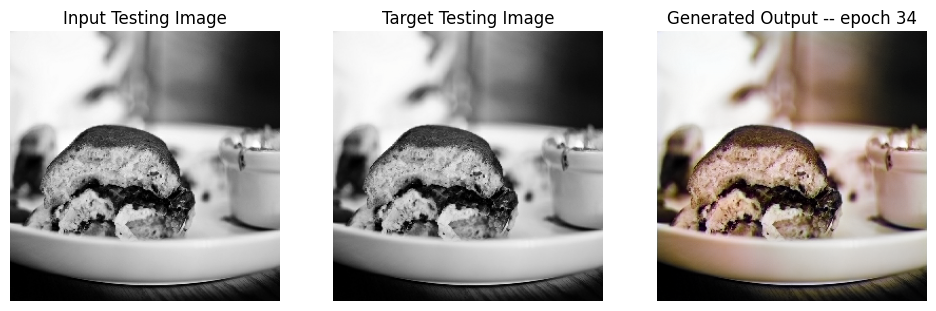

SSIM Score: 0.97564697265625
PSNR Score: 25.229074478149414
Epoch 34
Training Details
Generator-- total_loss:4.73449 gan_loss:0.01151 l1_loss:0.04039 perceptual_loss:0.00855 Discriminator-- total_loss:12.97371 real_loss:12.97323 generated_loss:0.00048 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 35 is 263.28312611579895 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.43668 gan_loss:0.00003 l1_loss:0.04702  perceptual_loss:0.00919 Discriminator-- total_loss:15.57427 real_loss:15.57406 generated_loss:0.00021 --- SSIM 0.91579 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 35 is 285.82371044158936 sec
Number of iteration 32
Epoch 35
Training Details
Generator-- total_loss:4.69565 gan_loss:0.01192 l1_loss:0.03998 perceptual_loss:0.00857 Discriminator-- total_loss:13.00478 real_loss:13.00466 generated_loss:0.00012 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 36 is 262.145037651062 sec
Number of iteration 250
Validation Details


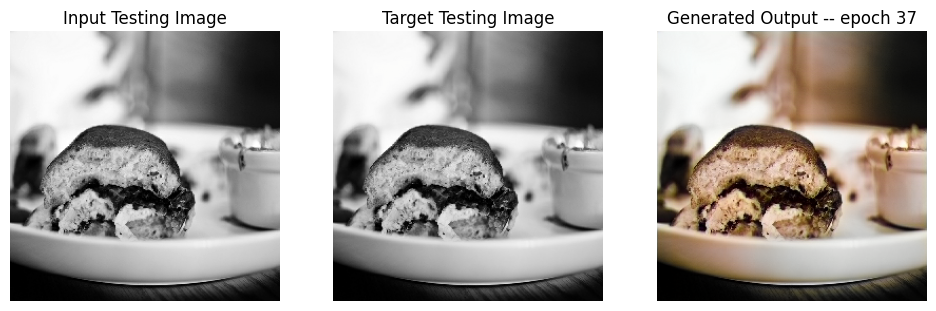

SSIM Score: 0.9697217345237732
PSNR Score: 23.253015518188477
Reduced discriminator learning rate to 0.0003000000142492354 at epoch 37.
Epoch 37
Training Details
Generator-- total_loss:13.38265 gan_loss:8.64139 l1_loss:0.04057 perceptual_loss:0.00856 Discriminator-- total_loss:0.25103 real_loss:0.15497 generated_loss:0.09606 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 38 is 197.45505142211914 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.72184 gan_loss:0.29972 l1_loss:0.04621  perceptual_loss:0.01002 Discriminator-- total_loss:2.79501 real_loss:2.47712 generated_loss:0.31789 --- SSIM 0.91449 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 38 is 218.90028858184814 sec
Number of iteration 32
Epoch 38
Training Details
Generator-- total_loss:15.71028 gan_loss:11.08858 l1_loss:0.03955 perceptual_loss:0.00833 Discriminator-- total_loss:0.04471 real_loss:0.01869 generated_loss:0.02603 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epo

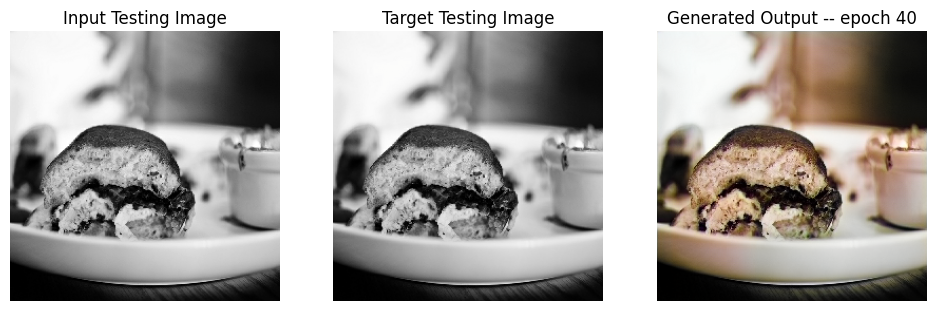

SSIM Score: 0.9746139049530029
PSNR Score: 24.03000259399414
Epoch 40
Training Details
Generator-- total_loss:18.72607 gan_loss:14.05826 l1_loss:0.03995 perceptual_loss:0.00841 Discriminator-- total_loss:0.00161 real_loss:0.00064 generated_loss:0.00097 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 41 is 195.19588232040405 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.10831 gan_loss:0.03010 l1_loss:0.04328  perceptual_loss:0.00938 Discriminator-- total_loss:6.70190 real_loss:6.67416 generated_loss:0.02774 --- SSIM 0.92280 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 41 is 216.10090112686157 sec
Number of iteration 32
Epoch 41
Training Details
Generator-- total_loss:19.35986 gan_loss:14.70521 l1_loss:0.03983 perceptual_loss:0.00840 Discriminator-- total_loss:0.00096 real_loss:0.00046 generated_loss:0.00050 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 42 is 195.15705013275146 sec
Number of iteration 250
Validation Details

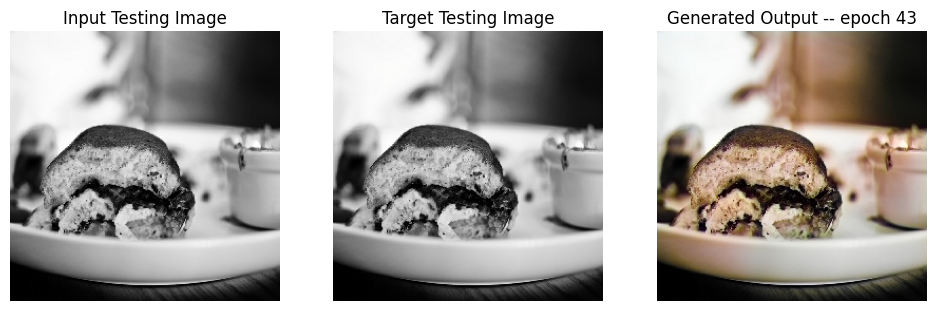

SSIM Score: 0.9740361571311951
PSNR Score: 23.909320831298828
Epoch 43
Training Details
Generator-- total_loss:16.81235 gan_loss:12.11541 l1_loss:0.04024 perceptual_loss:0.00842 Discriminator-- total_loss:0.00775 real_loss:0.00387 generated_loss:0.00388 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 44 is 198.3273904323578 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.43392 gan_loss:0.07474 l1_loss:0.04579  perceptual_loss:0.00975 Discriminator-- total_loss:4.48430 real_loss:4.45297 generated_loss:0.03133 --- SSIM 0.91568 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 44 is 219.35482907295227 sec
Number of iteration 32
Epoch 44
Training Details
Generator-- total_loss:17.82200 gan_loss:13.10923 l1_loss:0.04037 perceptual_loss:0.00844 Discriminator-- total_loss:0.00096 real_loss:0.00041 generated_loss:0.00055 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 45 is 196.11510562896729 sec
Number of iteration 250
Validation Details

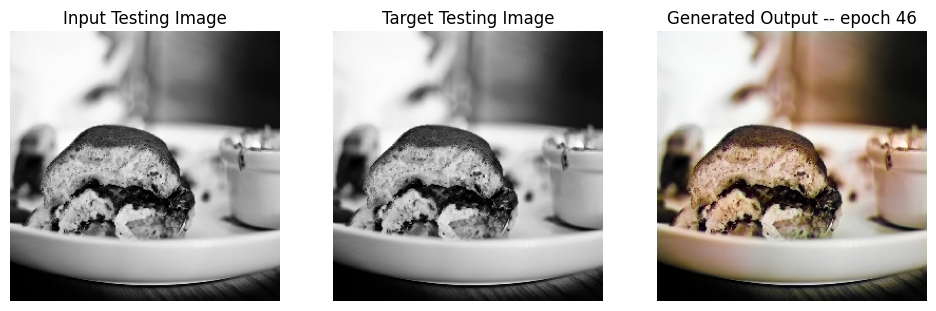

SSIM Score: 0.9737882018089294
PSNR Score: 23.8388614654541
Epoch 46
Training Details
Generator-- total_loss:18.19223 gan_loss:13.52877 l1_loss:0.03994 perceptual_loss:0.00837 Discriminator-- total_loss:0.00083 real_loss:0.00041 generated_loss:0.00042 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 47 is 194.67831349372864 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.20208 gan_loss:0.03159 l1_loss:0.04399  perceptual_loss:0.00964 Discriminator-- total_loss:5.62797 real_loss:5.60647 generated_loss:0.02150 --- SSIM 0.91642 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 47 is 215.53702306747437 sec
Number of iteration 32
Epoch 47
Training Details
Generator-- total_loss:17.96632 gan_loss:13.28009 l1_loss:0.04009 perceptual_loss:0.00846 Discriminator-- total_loss:0.09556 real_loss:0.06369 generated_loss:0.03187 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 48 is 195.84249424934387 sec
Number of iteration 250
Validation Details


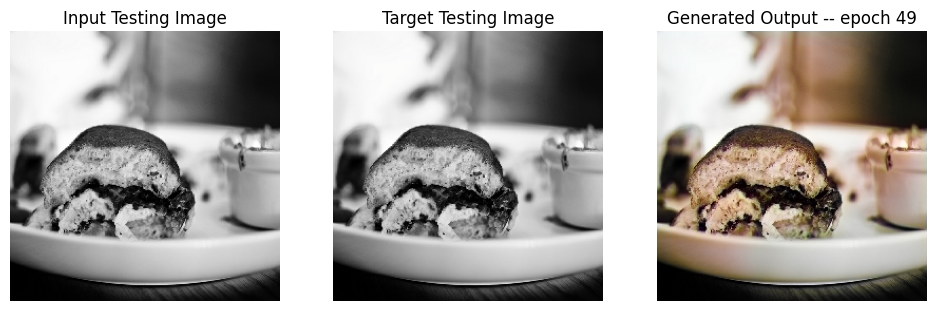

SSIM Score: 0.9747524857521057
PSNR Score: 24.025474548339844
Epoch 49
Training Details
Generator-- total_loss:18.44176 gan_loss:13.82988 l1_loss:0.03945 perceptual_loss:0.00834 Discriminator-- total_loss:0.00105 real_loss:0.00044 generated_loss:0.00060 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 50 is 195.84276151657104 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.41829 gan_loss:0.08188 l1_loss:0.04566  perceptual_loss:0.00963 Discriminator-- total_loss:4.15427 real_loss:4.11082 generated_loss:0.04345 --- SSIM 0.91621 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 50 is 216.95626950263977 sec
Number of iteration 32
Epoch 50
Training Details
Generator-- total_loss:19.51345 gan_loss:14.73370 l1_loss:0.04088 perceptual_loss:0.00864 Discriminator-- total_loss:0.00060 real_loss:0.00020 generated_loss:0.00040 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 51 is 195.78362464904785 sec
Number of iteration 250
Validation Detail

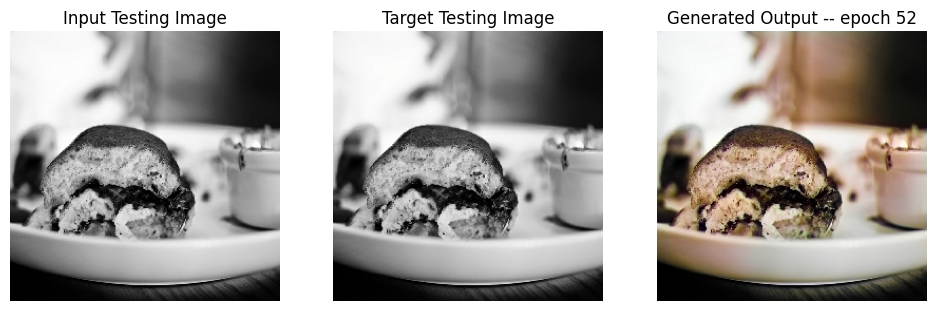

SSIM Score: 0.9745717644691467
PSNR Score: 24.035869598388672
Epoch 52
Training Details
Generator-- total_loss:19.05426 gan_loss:14.33262 l1_loss:0.04039 perceptual_loss:0.00853 Discriminator-- total_loss:0.00118 real_loss:0.00040 generated_loss:0.00078 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 53 is 196.62304186820984 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.12843 gan_loss:0.02591 l1_loss:0.04333  perceptual_loss:0.00962 Discriminator-- total_loss:5.64747 real_loss:5.63138 generated_loss:0.01610 --- SSIM 0.91896 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 53 is 217.9591405391693 sec
Number of iteration 32
Epoch 53
Training Details
Generator-- total_loss:19.43526 gan_loss:14.73175 l1_loss:0.04024 perceptual_loss:0.00850 Discriminator-- total_loss:0.05293 real_loss:0.02761 generated_loss:0.02532 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 54 is 196.63205766677856 sec
Number of iteration 250
Validation Details

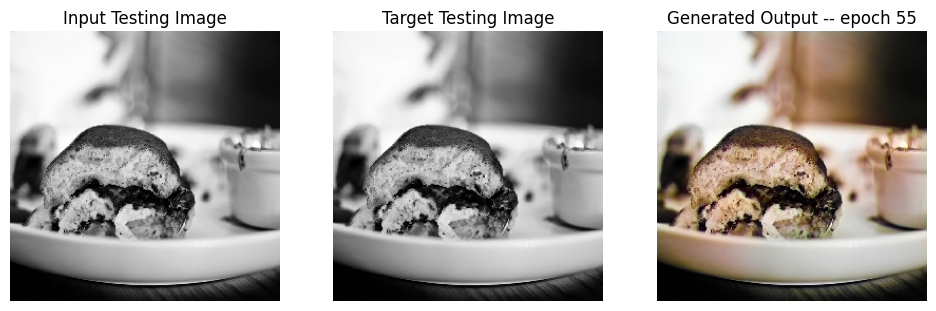

SSIM Score: 0.9736719727516174
PSNR Score: 23.79059600830078
Epoch 55
Training Details
Generator-- total_loss:21.33151 gan_loss:16.55208 l1_loss:0.04086 perceptual_loss:0.00866 Discriminator-- total_loss:0.00138 real_loss:0.00064 generated_loss:0.00074 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 56 is 196.3514006137848 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.33582 gan_loss:0.03688 l1_loss:0.04536  perceptual_loss:0.00953 Discriminator-- total_loss:6.54435 real_loss:6.52944 generated_loss:0.01491 --- SSIM 0.91421 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 56 is 217.6522262096405 sec
Number of iteration 32
Epoch 56
Training Details
Generator-- total_loss:22.00690 gan_loss:17.21152 l1_loss:0.04114 perceptual_loss:0.00852 Discriminator-- total_loss:0.00038 real_loss:0.00021 generated_loss:0.00017 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 57 is 195.40600991249084 sec
Number of iteration 250
Validation Details
G

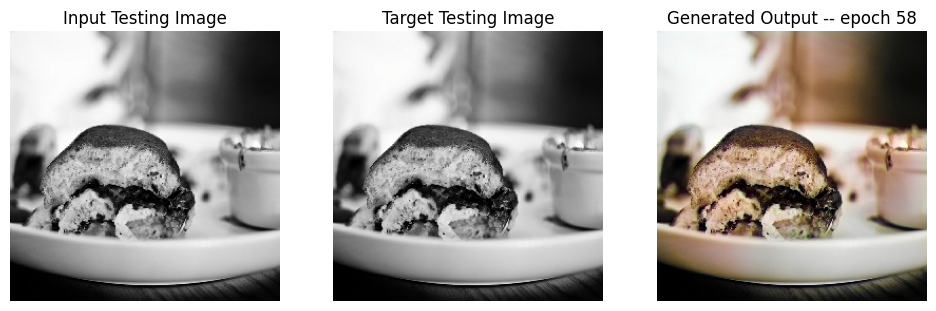

SSIM Score: 0.9741904139518738
PSNR Score: 23.900230407714844
Epoch 58
Training Details
Generator-- total_loss:22.43172 gan_loss:17.71533 l1_loss:0.04039 perceptual_loss:0.00847 Discriminator-- total_loss:0.00033 real_loss:0.00015 generated_loss:0.00019 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 59 is 195.20888876914978 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.24092 gan_loss:0.01821 l1_loss:0.04481  perceptual_loss:0.00928 Discriminator-- total_loss:7.11775 real_loss:7.10739 generated_loss:0.01036 --- SSIM 0.91841 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 59 is 216.6684422492981 sec
Number of iteration 32
Epoch 59
Training Details
Generator-- total_loss:23.36610 gan_loss:18.64008 l1_loss:0.04045 perceptual_loss:0.00852 Discriminator-- total_loss:0.00031 real_loss:0.00015 generated_loss:0.00015 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 60 is 195.17797088623047 sec
Number of iteration 250
Validation Details

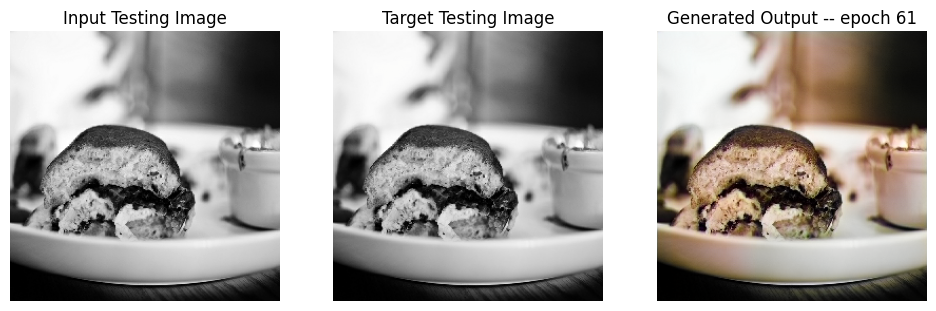

SSIM Score: 0.9739043116569519
PSNR Score: 23.849170684814453
Epoch 61
Training Details
Generator-- total_loss:22.72345 gan_loss:18.01374 l1_loss:0.04028 perceptual_loss:0.00852 Discriminator-- total_loss:0.00250 real_loss:0.00102 generated_loss:0.00148 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 62 is 195.8470721244812 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.06223 gan_loss:0.06369 l1_loss:0.04240  perceptual_loss:0.00948 Discriminator-- total_loss:7.27442 real_loss:7.13682 generated_loss:0.13761 --- SSIM 0.92132 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 62 is 216.8546326160431 sec
Number of iteration 32
Epoch 62
Training Details
Generator-- total_loss:24.43406 gan_loss:19.70800 l1_loss:0.04050 perceptual_loss:0.00845 Discriminator-- total_loss:0.00013 real_loss:0.00006 generated_loss:0.00007 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 63 is 195.29916763305664 sec
Number of iteration 250
Validation Details


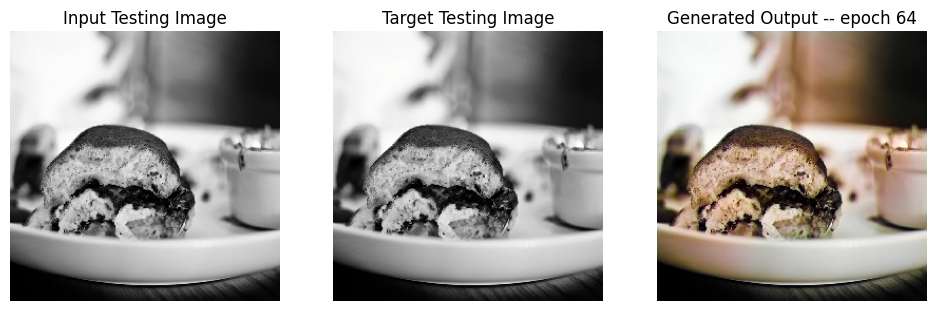

SSIM Score: 0.9734967350959778
PSNR Score: 23.8129940032959
Epoch 64
Training Details
Generator-- total_loss:24.98930 gan_loss:20.30073 l1_loss:0.04013 perceptual_loss:0.00844 Discriminator-- total_loss:0.00007 real_loss:0.00003 generated_loss:0.00004 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 65 is 195.70630264282227 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.05603 gan_loss:0.01863 l1_loss:0.04307  perceptual_loss:0.00913 Discriminator-- total_loss:7.18121 real_loss:7.17248 generated_loss:0.00873 --- SSIM 0.92160 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 65 is 216.63970184326172 sec
Number of iteration 32
Epoch 65
Training Details
Generator-- total_loss:25.50908 gan_loss:20.75689 l1_loss:0.04065 perceptual_loss:0.00859 Discriminator-- total_loss:0.00005 real_loss:0.00002 generated_loss:0.00002 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 66 is 195.1835422515869 sec
Number of iteration 250
Validation Details
G

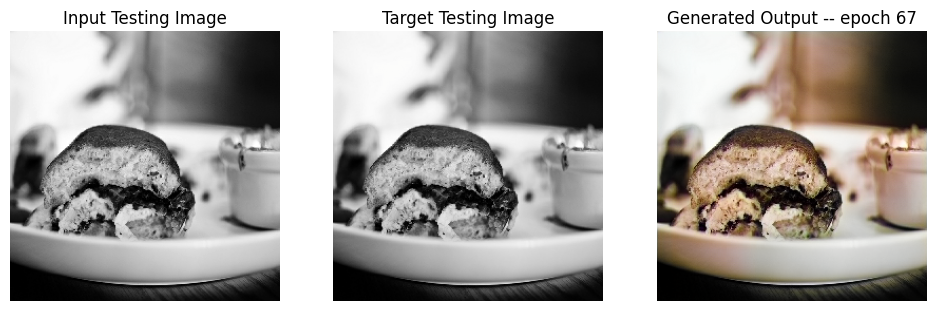

SSIM Score: 0.9749126434326172
PSNR Score: 24.072704315185547
Epoch 67
Training Details
Generator-- total_loss:21.60699 gan_loss:16.94141 l1_loss:0.03993 perceptual_loss:0.00841 Discriminator-- total_loss:0.01478 real_loss:0.00526 generated_loss:0.00952 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 68 is 195.10735630989075 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.34625 gan_loss:0.06004 l1_loss:0.04531  perceptual_loss:0.00944 Discriminator-- total_loss:5.30088 real_loss:5.28528 generated_loss:0.01560 --- SSIM 0.91493 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 68 is 216.29280185699463 sec
Number of iteration 32
Epoch 68
Training Details
Generator-- total_loss:22.59950 gan_loss:17.92646 l1_loss:0.03998 perceptual_loss:0.00844 Discriminator-- total_loss:0.00041 real_loss:0.00016 generated_loss:0.00025 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 69 is 194.95154571533203 sec
Number of iteration 250
Validation Detail

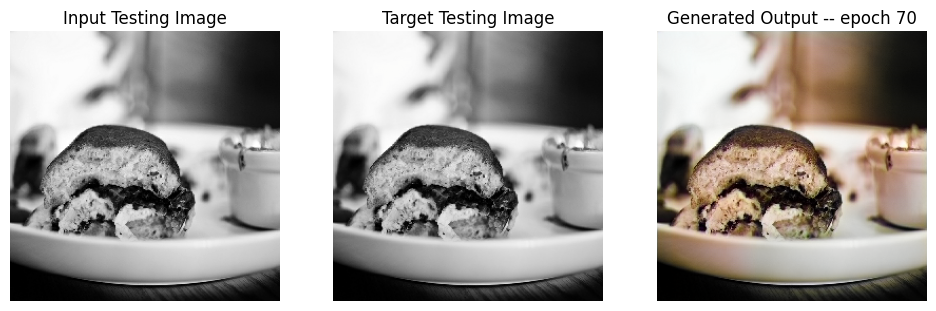

SSIM Score: 0.9746319651603699
PSNR Score: 23.96552085876465
Epoch 70
Training Details
Generator-- total_loss:23.03614 gan_loss:18.29357 l1_loss:0.04052 perceptual_loss:0.00863 Discriminator-- total_loss:0.00138 real_loss:0.00063 generated_loss:0.00075 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 71 is 196.31100702285767 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.27215 gan_loss:0.01866 l1_loss:0.04508  perceptual_loss:0.00932 Discriminator-- total_loss:6.27993 real_loss:6.27050 generated_loss:0.00943 --- SSIM 0.91718 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 71 is 217.59445333480835 sec
Number of iteration 32
Epoch 71
Training Details
Generator-- total_loss:23.93699 gan_loss:19.19241 l1_loss:0.04067 perceptual_loss:0.00847 Discriminator-- total_loss:0.00015 real_loss:0.00008 generated_loss:0.00007 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 72 is 196.85569596290588 sec
Number of iteration 250
Validation Details

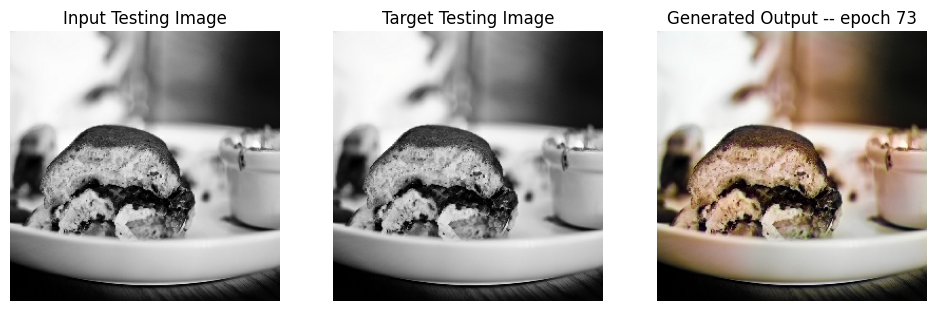

SSIM Score: 0.9738847613334656
PSNR Score: 23.862411499023438
Epoch 73
Training Details
Generator-- total_loss:23.67418 gan_loss:19.02464 l1_loss:0.03979 perceptual_loss:0.00839 Discriminator-- total_loss:0.00010 real_loss:0.00005 generated_loss:0.00005 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 74 is 197.43763947486877 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.20509 gan_loss:0.01681 l1_loss:0.04438  perceptual_loss:0.00938 Discriminator-- total_loss:6.44083 real_loss:6.43295 generated_loss:0.00788 --- SSIM 0.92009 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 74 is 218.70027494430542 sec
Number of iteration 32
Reduced generator learning rate to 0.0002025000096182339 at epoch 74
Epoch 74
Training Details
Generator-- total_loss:5.19253 gan_loss:0.13316 l1_loss:0.04352 perceptual_loss:0.00884 Discriminator-- total_loss:11.22006 real_loss:11.22000 generated_loss:0.00006 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 7

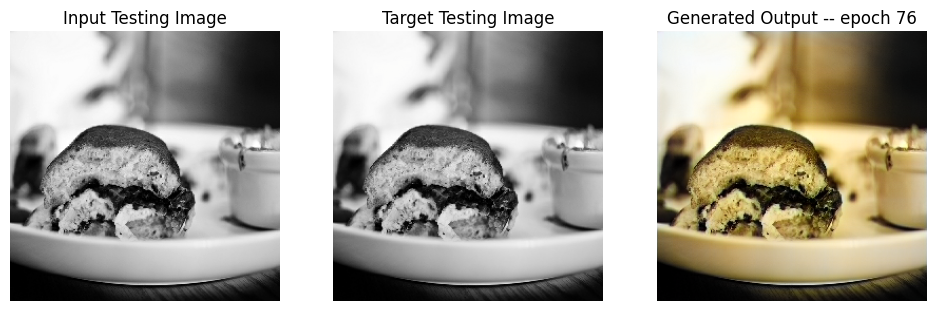

SSIM Score: 0.9431324005126953
PSNR Score: 18.78185272216797
Epoch 76
Training Details
Generator-- total_loss:4.86371 gan_loss:0.01940 l1_loss:0.04149 perceptual_loss:0.00870 Discriminator-- total_loss:9.51846 real_loss:9.51837 generated_loss:0.00009 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 77 is 261.43569254875183 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.56053 gan_loss:0.00010 l1_loss:0.04768  perceptual_loss:0.00991 Discriminator-- total_loss:12.83142 real_loss:12.83136 generated_loss:0.00006 --- SSIM 0.91165 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 77 is 282.69348073005676 sec
Number of iteration 32
Epoch 77
Training Details
Generator-- total_loss:4.82167 gan_loss:0.01514 l1_loss:0.04123 perceptual_loss:0.00854 Discriminator-- total_loss:9.20843 real_loss:9.20831 generated_loss:0.00012 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 78 is 261.3803186416626 sec
Number of iteration 250
Validation Details
Ge

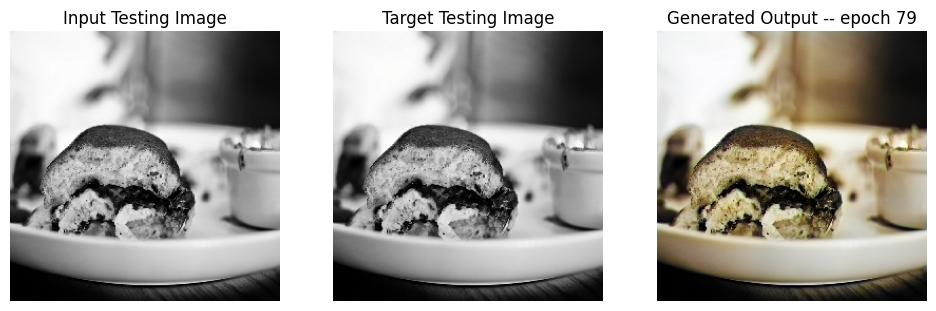

SSIM Score: 0.973889172077179
PSNR Score: 23.462764739990234
Epoch 79
Training Details
Generator-- total_loss:4.84028 gan_loss:0.01936 l1_loss:0.04133 perceptual_loss:0.00860 Discriminator-- total_loss:9.39014 real_loss:9.39010 generated_loss:0.00004 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 80 is 260.8674352169037 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.98204 gan_loss:0.00009 l1_loss:0.05168  perceptual_loss:0.01017 Discriminator-- total_loss:14.28618 real_loss:14.28611 generated_loss:0.00007 --- SSIM 0.90121 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 80 is 282.11899042129517 sec
Number of iteration 32
Epoch 80
Training Details
Generator-- total_loss:4.86906 gan_loss:0.01449 l1_loss:0.04162 perceptual_loss:0.00865 Discriminator-- total_loss:8.87377 real_loss:8.87372 generated_loss:0.00005 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 81 is 260.6426136493683 sec
Number of iteration 250
Validation Details
Gen

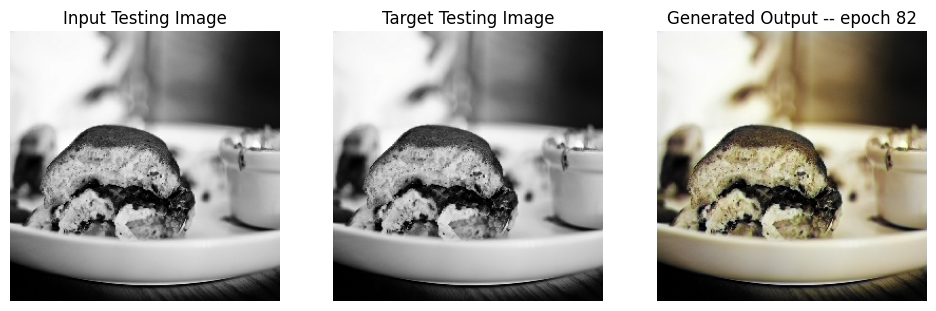

SSIM Score: 0.9770541191101074
PSNR Score: 23.80023765563965
Epoch 82
Training Details
Generator-- total_loss:4.79838 gan_loss:0.01351 l1_loss:0.04100 perceptual_loss:0.00856 Discriminator-- total_loss:8.94959 real_loss:8.94956 generated_loss:0.00004 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 83 is 261.86534810066223 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.29989 gan_loss:0.00008 l1_loss:0.04511  perceptual_loss:0.00987 Discriminator-- total_loss:12.58014 real_loss:12.58006 generated_loss:0.00007 --- SSIM 0.91467 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 83 is 283.0580196380615 sec
Number of iteration 32
Epoch 83
Training Details
Generator-- total_loss:4.80092 gan_loss:0.01384 l1_loss:0.04104 perceptual_loss:0.00854 Discriminator-- total_loss:9.18325 real_loss:9.18105 generated_loss:0.00220 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 84 is 261.2569456100464 sec
Number of iteration 250
Validation Details
Gen

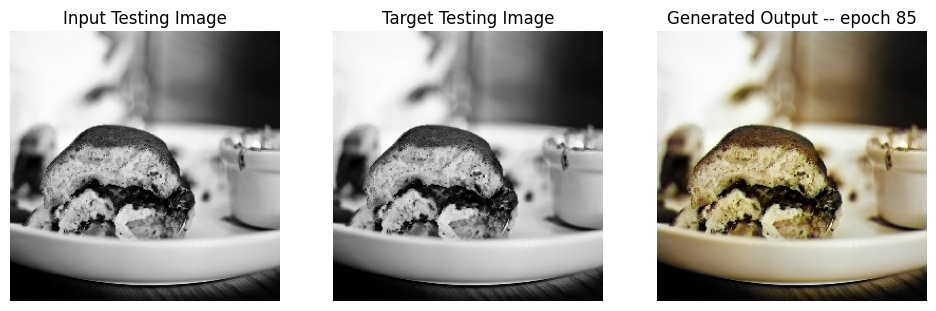

SSIM Score: 0.9678950309753418
PSNR Score: 23.092666625976562
Epoch 85
Training Details
Generator-- total_loss:4.78017 gan_loss:0.01427 l1_loss:0.04087 perceptual_loss:0.00849 Discriminator-- total_loss:9.02403 real_loss:9.02387 generated_loss:0.00016 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 86 is 261.06279397010803 sec
Number of iteration 250
Validation Details
Generator-- total_loss:7.78734 gan_loss:0.00007 l1_loss:0.06939  perceptual_loss:0.01060 Discriminator-- total_loss:18.42978 real_loss:18.42971 generated_loss:0.00007 --- SSIM 0.87572 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 86 is 281.80962586402893 sec
Number of iteration 32
Epoch 86
Training Details
Generator-- total_loss:4.75138 gan_loss:0.01251 l1_loss:0.04064 perceptual_loss:0.00843 Discriminator-- total_loss:8.87127 real_loss:8.87115 generated_loss:0.00012 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 87 is 259.9029288291931 sec
Number of iteration 250
Validation Details
G

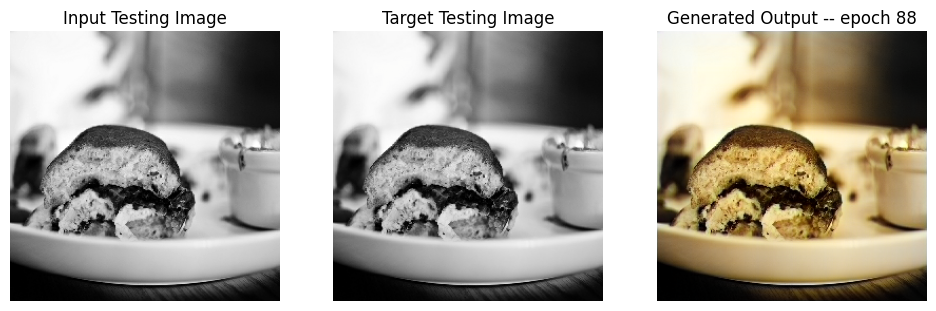

SSIM Score: 0.9373896718025208
PSNR Score: 18.93165397644043
Reduced discriminator learning rate to 9.000000427477062e-05 at epoch 88.
Epoch 88
Training Details
Generator-- total_loss:12.63216 gan_loss:7.86145 l1_loss:0.04088 perceptual_loss:0.00854 Discriminator-- total_loss:0.10646 real_loss:0.06601 generated_loss:0.04045 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 89 is 197.0157446861267 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.20653 gan_loss:0.13026 l1_loss:0.04339  perceptual_loss:0.00922 Discriminator-- total_loss:3.09382 real_loss:2.82287 generated_loss:0.27095 --- SSIM 0.91715 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 89 is 218.09687662124634 sec
Number of iteration 32
Epoch 89
Training Details
Generator-- total_loss:14.26173 gan_loss:9.45399 l1_loss:0.04117 perceptual_loss:0.00864 Discriminator-- total_loss:0.00763 real_loss:0.00339 generated_loss:0.00424 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 

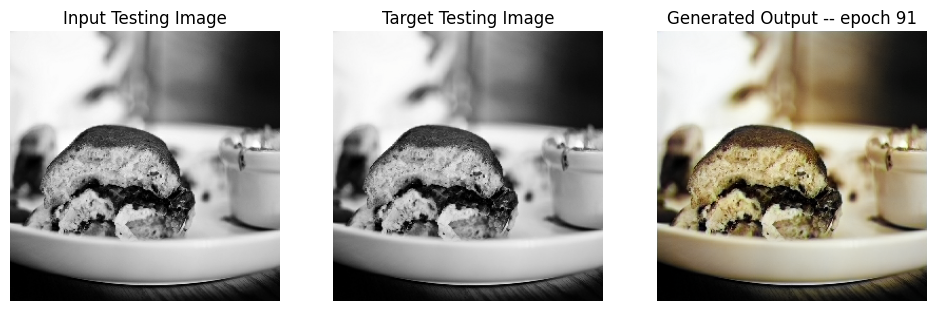

SSIM Score: 0.9734119772911072
PSNR Score: 23.274171829223633
Epoch 91
Training Details
Generator-- total_loss:16.23230 gan_loss:11.46926 l1_loss:0.04083 perceptual_loss:0.00851 Discriminator-- total_loss:0.00149 real_loss:0.00053 generated_loss:0.00096 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 92 is 196.0953450202942 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.25966 gan_loss:0.06303 l1_loss:0.04459  perceptual_loss:0.00922 Discriminator-- total_loss:4.56755 real_loss:4.49580 generated_loss:0.07176 --- SSIM 0.91502 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 92 is 216.90495324134827 sec
Number of iteration 32
Epoch 92
Training Details
Generator-- total_loss:15.84204 gan_loss:11.10409 l1_loss:0.04061 perceptual_loss:0.00846 Discriminator-- total_loss:0.00552 real_loss:0.00219 generated_loss:0.00334 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 93 is 195.917706489563 sec
Number of iteration 250
Validation Details
G

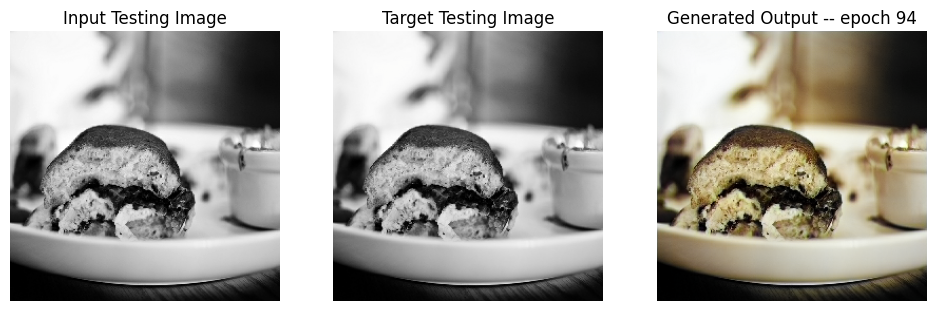

SSIM Score: 0.9735908508300781
PSNR Score: 23.3652286529541
Epoch 94
Training Details
Generator-- total_loss:16.26628 gan_loss:11.49147 l1_loss:0.04091 perceptual_loss:0.00854 Discriminator-- total_loss:0.01431 real_loss:0.00537 generated_loss:0.00894 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 95 is 199.5110855102539 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.65583 gan_loss:0.05097 l1_loss:0.04817  perceptual_loss:0.00985 Discriminator-- total_loss:4.16661 real_loss:4.11007 generated_loss:0.05654 --- SSIM 0.90581 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 95 is 220.38332176208496 sec
Number of iteration 32
Epoch 95
Training Details
Generator-- total_loss:16.41129 gan_loss:11.62878 l1_loss:0.04093 perceptual_loss:0.00862 Discriminator-- total_loss:0.00164 real_loss:0.00098 generated_loss:0.00066 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 96 is 196.43533205986023 sec
Number of iteration 250
Validation Details
G

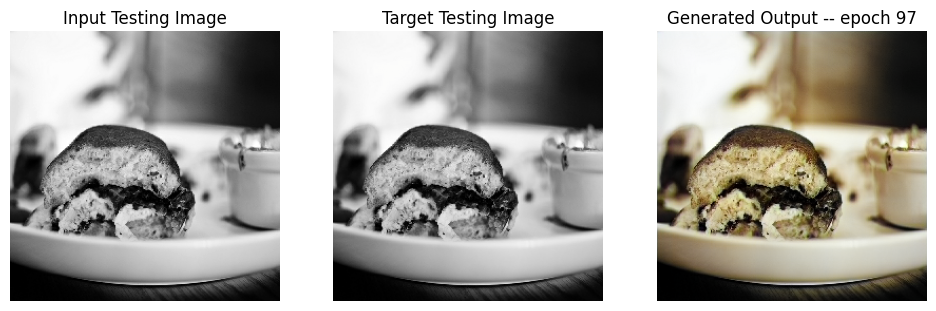

SSIM Score: 0.973172664642334
PSNR Score: 23.288101196289062
Epoch 97
Training Details
Generator-- total_loss:18.07030 gan_loss:13.27155 l1_loss:0.04116 perceptual_loss:0.00854 Discriminator-- total_loss:0.00365 real_loss:0.00187 generated_loss:0.00178 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 98 is 197.75987768173218 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.22698 gan_loss:0.08907 l1_loss:0.04383  perceptual_loss:0.00944 Discriminator-- total_loss:3.52993 real_loss:3.40703 generated_loss:0.12290 --- SSIM 0.91560 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 98 is 218.74685788154602 sec
Number of iteration 32
Epoch 98
Training Details
Generator-- total_loss:17.20005 gan_loss:12.46762 l1_loss:0.04052 perceptual_loss:0.00850 Discriminator-- total_loss:0.00150 real_loss:0.00050 generated_loss:0.00100 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 99 is 197.9780809879303 sec
Number of iteration 250
Validation Details


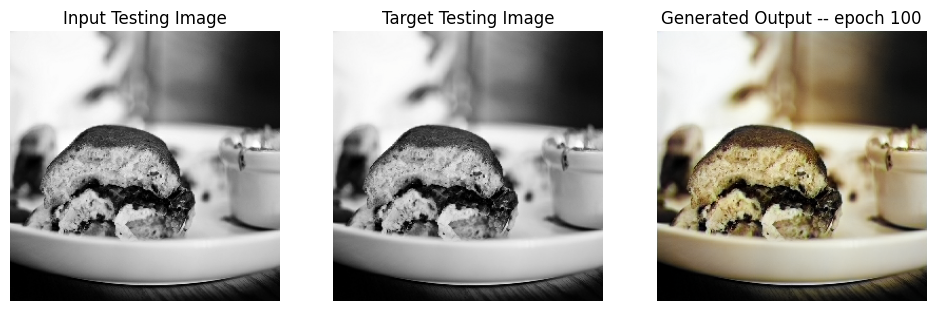

SSIM Score: 0.9736471176147461
PSNR Score: 23.28628921508789
Epoch 100
Training Details
Generator-- total_loss:18.32414 gan_loss:13.56714 l1_loss:0.04070 perceptual_loss:0.00858 Discriminator-- total_loss:0.00036 real_loss:0.00016 generated_loss:0.00020 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 101 is 197.85377287864685 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.20026 gan_loss:0.04299 l1_loss:0.04442  perceptual_loss:0.00894 Discriminator-- total_loss:4.35937 real_loss:4.28667 generated_loss:0.07270 --- SSIM 0.91195 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 101 is 219.10155320167542 sec
Number of iteration 32
Epoch 101
Training Details
Generator-- total_loss:18.66580 gan_loss:13.90762 l1_loss:0.04071 perceptual_loss:0.00859 Discriminator-- total_loss:0.00033 real_loss:0.00013 generated_loss:0.00020 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 102 is 198.07211089134216 sec
Number of iteration 250
Validation De

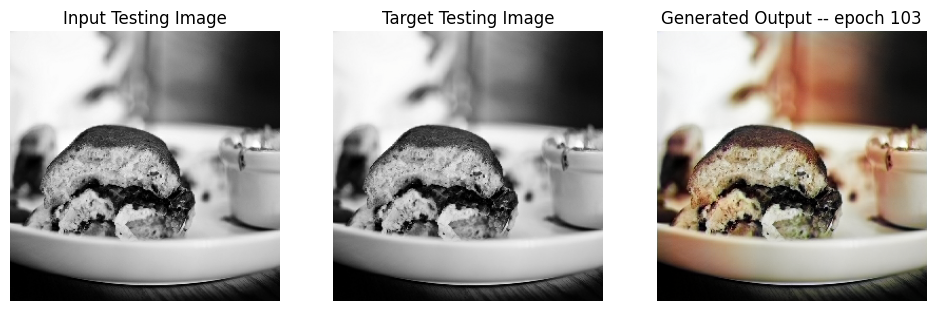

SSIM Score: 0.9712052345275879
PSNR Score: 22.842729568481445
Epoch 103
Training Details
Generator-- total_loss:4.89886 gan_loss:0.03075 l1_loss:0.04187 perceptual_loss:0.00851 Discriminator-- total_loss:12.14505 real_loss:12.14479 generated_loss:0.00026 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 104 is 261.65605187416077 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.07001 gan_loss:0.00006 l1_loss:0.04317  perceptual_loss:0.00942 Discriminator-- total_loss:15.80399 real_loss:15.80389 generated_loss:0.00010 --- SSIM 0.91887 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 104 is 283.46342515945435 sec
Number of iteration 32
Epoch 104
Training Details
Generator-- total_loss:4.87762 gan_loss:0.01847 l1_loss:0.04178 perceptual_loss:0.00851 Discriminator-- total_loss:11.42925 real_loss:11.42914 generated_loss:0.00011 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 105 is 261.3518486022949 sec
Number of iteration 250
Validation 

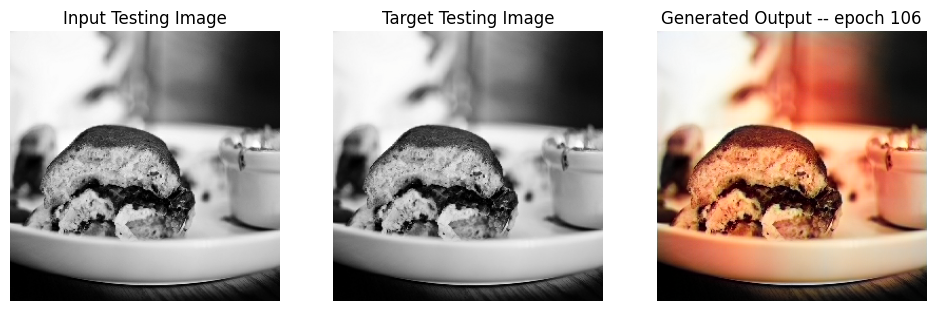

SSIM Score: 0.9100462794303894
PSNR Score: 16.18747901916504
Epoch 106
Training Details
Generator-- total_loss:4.80317 gan_loss:0.02189 l1_loss:0.04102 perceptual_loss:0.00849 Discriminator-- total_loss:10.87979 real_loss:10.87958 generated_loss:0.00021 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 107 is 263.00123286247253 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.16712 gan_loss:0.00008 l1_loss:0.04421  perceptual_loss:0.00932 Discriminator-- total_loss:15.13683 real_loss:15.13675 generated_loss:0.00008 --- SSIM 0.91579 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 107 is 284.47933435440063 sec
Number of iteration 32
Epoch 107
Training Details
Generator-- total_loss:4.86924 gan_loss:0.02031 l1_loss:0.04159 perceptual_loss:0.00863 Discriminator-- total_loss:11.20077 real_loss:11.20066 generated_loss:0.00011 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 108 is 262.7843236923218 sec
Number of iteration 250
Validation D

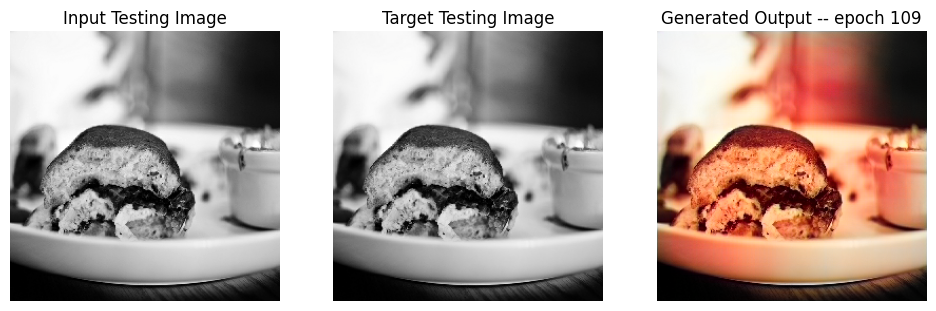

SSIM Score: 0.8801896572113037
PSNR Score: 15.177530288696289
Epoch 109
Training Details
Generator-- total_loss:4.88241 gan_loss:0.01735 l1_loss:0.04179 perceptual_loss:0.00858 Discriminator-- total_loss:10.76767 real_loss:10.76738 generated_loss:0.00029 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 110 is 263.79939913749695 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.54944 gan_loss:0.00010 l1_loss:0.04788  perceptual_loss:0.00952 Discriminator-- total_loss:14.31619 real_loss:14.31610 generated_loss:0.00009 --- SSIM 0.91364 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 110 is 284.95669174194336 sec
Number of iteration 32
Epoch 110
Training Details
Generator-- total_loss:4.78707 gan_loss:0.01735 l1_loss:0.04099 perceptual_loss:0.00838 Discriminator-- total_loss:10.39025 real_loss:10.38998 generated_loss:0.00026 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 111 is 261.7635889053345 sec
Number of iteration 250
Validation 

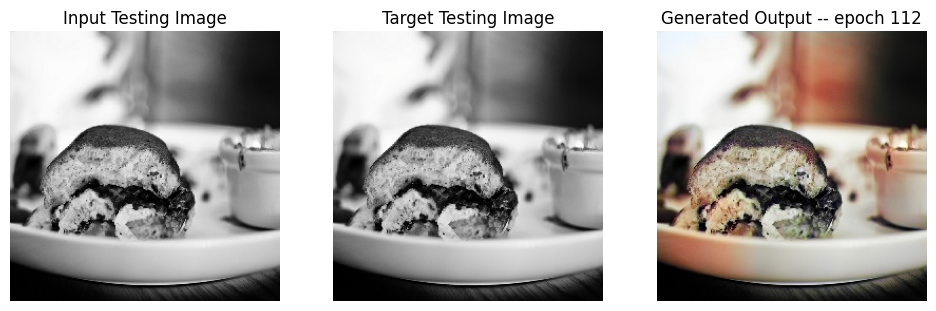

SSIM Score: 0.9739226698875427
PSNR Score: 23.44548225402832
Epoch 112
Training Details
Generator-- total_loss:4.78548 gan_loss:0.01596 l1_loss:0.04091 perceptual_loss:0.00848 Discriminator-- total_loss:10.23984 real_loss:10.23964 generated_loss:0.00021 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 113 is 262.440313577652 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.19238 gan_loss:0.00011 l1_loss:0.04416  perceptual_loss:0.00971 Discriminator-- total_loss:13.98733 real_loss:13.98722 generated_loss:0.00011 --- SSIM 0.91849 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 113 is 283.81472063064575 sec
Number of iteration 32
Epoch 113
Training Details
Generator-- total_loss:4.80295 gan_loss:0.02046 l1_loss:0.04112 perceptual_loss:0.00838 Discriminator-- total_loss:10.55251 real_loss:10.54829 generated_loss:0.00422 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 114 is 263.9378116130829 sec
Number of iteration 250
Validation Det

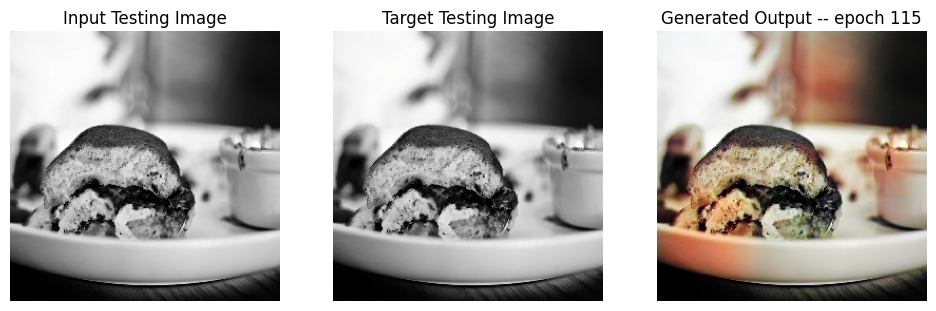

SSIM Score: 0.9684411883354187
PSNR Score: 22.293664932250977
Epoch 115
Training Details
Generator-- total_loss:4.83161 gan_loss:0.01855 l1_loss:0.04137 perceptual_loss:0.00845 Discriminator-- total_loss:10.54544 real_loss:10.54531 generated_loss:0.00014 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 116 is 263.185090303421 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.26547 gan_loss:0.00010 l1_loss:0.04500  perceptual_loss:0.00957 Discriminator-- total_loss:14.44905 real_loss:14.44894 generated_loss:0.00011 --- SSIM 0.91671 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 116 is 284.89778423309326 sec
Number of iteration 32
Epoch 116
Training Details
Generator-- total_loss:4.81914 gan_loss:0.01984 l1_loss:0.04122 perceptual_loss:0.00847 Discriminator-- total_loss:10.38708 real_loss:10.38693 generated_loss:0.00015 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 117 is 263.2328176498413 sec
Number of iteration 250
Validation De

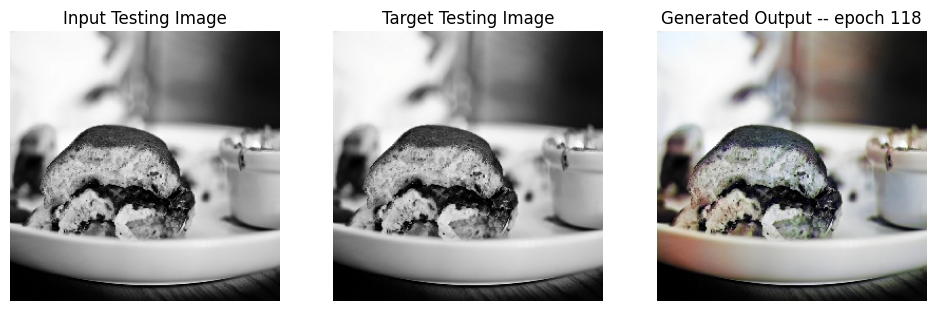

SSIM Score: 0.9890497326850891
PSNR Score: 30.406339645385742
Epoch 118
Training Details
Generator-- total_loss:4.76968 gan_loss:0.01674 l1_loss:0.04085 perceptual_loss:0.00836 Discriminator-- total_loss:10.28197 real_loss:10.28156 generated_loss:0.00041 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 119 is 263.44893527030945 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.04804 gan_loss:0.00010 l1_loss:0.04292  perceptual_loss:0.00945 Discriminator-- total_loss:14.52226 real_loss:14.52215 generated_loss:0.00011 --- SSIM 0.92025 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 119 is 285.1883547306061 sec
Number of iteration 32
Epoch 119
Training Details
Generator-- total_loss:4.77130 gan_loss:0.01662 l1_loss:0.04080 perceptual_loss:0.00843 Discriminator-- total_loss:10.38213 real_loss:10.38195 generated_loss:0.00018 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 120 is 263.1078770160675 sec
Number of iteration 250
Validation D

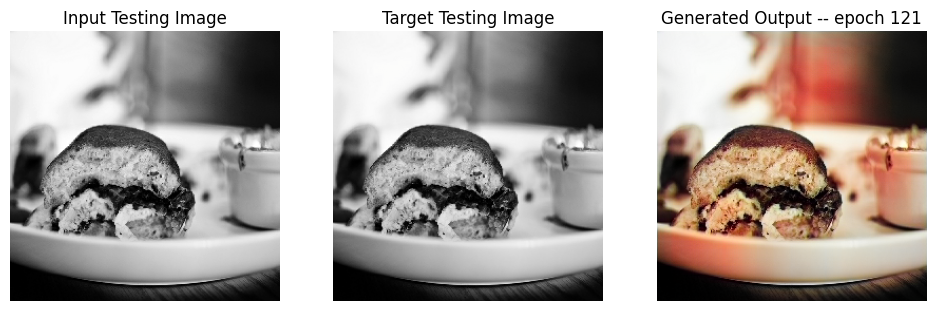

SSIM Score: 0.9408060908317566
PSNR Score: 18.990264892578125
Epoch 121
Training Details
Generator-- total_loss:4.71646 gan_loss:0.01648 l1_loss:0.04037 perceptual_loss:0.00829 Discriminator-- total_loss:10.43249 real_loss:10.43221 generated_loss:0.00028 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 122 is 264.1034483909607 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.56000 gan_loss:0.00005 l1_loss:0.04824  perceptual_loss:0.00919 Discriminator-- total_loss:18.02547 real_loss:18.02525 generated_loss:0.00022 --- SSIM 0.91328 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 122 is 285.54049277305603 sec
Number of iteration 32
Epoch 122
Training Details
Generator-- total_loss:4.78887 gan_loss:0.02207 l1_loss:0.04094 perceptual_loss:0.00841 Discriminator-- total_loss:10.89083 real_loss:10.89001 generated_loss:0.00082 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 123 is 262.9393799304962 sec
Number of iteration 250
Validation D

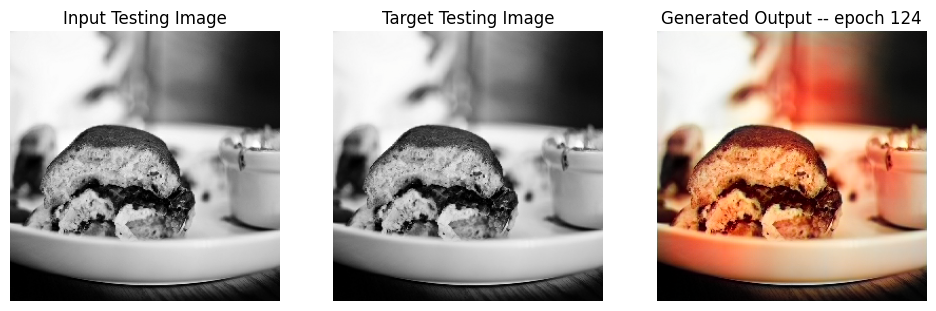

SSIM Score: 0.8887228965759277
PSNR Score: 15.861150741577148
Epoch 124
Training Details
Generator-- total_loss:4.74152 gan_loss:0.01585 l1_loss:0.04061 perceptual_loss:0.00831 Discriminator-- total_loss:10.37469 real_loss:10.37271 generated_loss:0.00198 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 125 is 263.5428442955017 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.29623 gan_loss:0.00009 l1_loss:0.04518  perceptual_loss:0.00973 Discriminator-- total_loss:15.24150 real_loss:15.24131 generated_loss:0.00019 --- SSIM 0.91581 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 125 is 284.4717712402344 sec
Number of iteration 32
Epoch 125
Training Details
Generator-- total_loss:4.74826 gan_loss:0.01889 l1_loss:0.04067 perceptual_loss:0.00828 Discriminator-- total_loss:10.15537 real_loss:10.15518 generated_loss:0.00019 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 126 is 263.6155800819397 sec
Number of iteration 250
Validation De

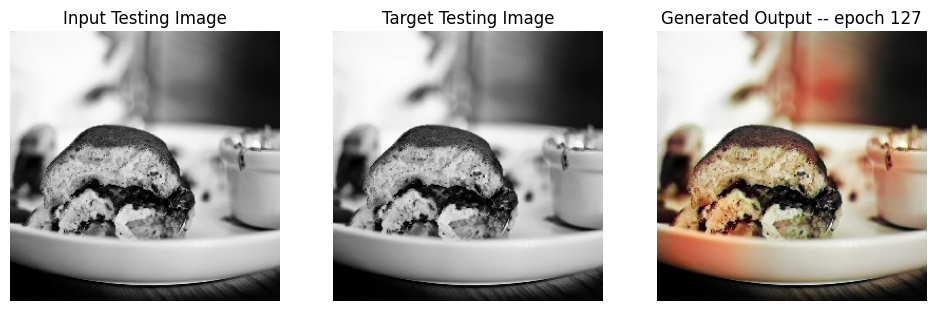

SSIM Score: 0.9589717984199524
PSNR Score: 21.096172332763672
Epoch 127
Training Details
Generator-- total_loss:4.80412 gan_loss:0.01508 l1_loss:0.04116 perceptual_loss:0.00842 Discriminator-- total_loss:10.18232 real_loss:10.18225 generated_loss:0.00007 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 128 is 263.60876297950745 sec
Number of iteration 250
Validation Details
Generator-- total_loss:6.31106 gan_loss:0.00004 l1_loss:0.05545  perceptual_loss:0.00957 Discriminator-- total_loss:19.49251 real_loss:19.49231 generated_loss:0.00020 --- SSIM 0.90513 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 128 is 284.59209632873535 sec
Number of iteration 32
Epoch 128
Training Details
Generator-- total_loss:4.74073 gan_loss:0.01920 l1_loss:0.04054 perceptual_loss:0.00834 Discriminator-- total_loss:10.15766 real_loss:10.15752 generated_loss:0.00014 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 129 is 263.6241502761841 sec
Number of iteration 250
Validation 

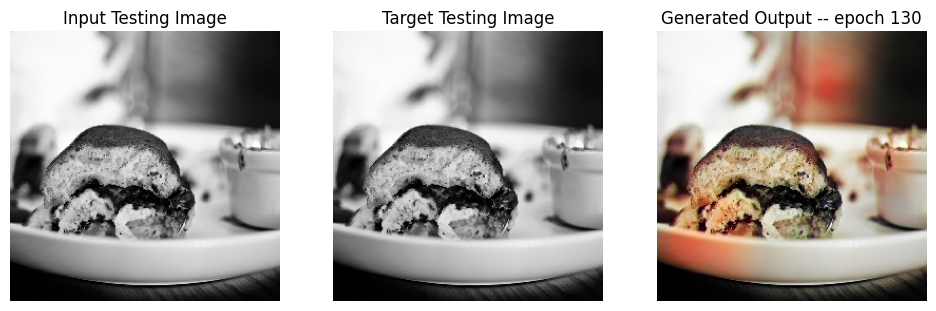

SSIM Score: 0.9601964950561523
PSNR Score: 21.372648239135742
Epoch 130
Training Details
Generator-- total_loss:4.81807 gan_loss:0.01623 l1_loss:0.04126 perceptual_loss:0.00845 Discriminator-- total_loss:10.25559 real_loss:10.25515 generated_loss:0.00045 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 131 is 263.4945619106293 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.56437 gan_loss:0.00007 l1_loss:0.04813  perceptual_loss:0.00939 Discriminator-- total_loss:17.70413 real_loss:17.70393 generated_loss:0.00020 --- SSIM 0.91516 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 131 is 284.8089487552643 sec
Number of iteration 32
Epoch 131
Training Details
Generator-- total_loss:4.82369 gan_loss:0.01754 l1_loss:0.04133 perceptual_loss:0.00841 Discriminator-- total_loss:10.23989 real_loss:10.23973 generated_loss:0.00016 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 132 is 263.34651136398315 sec
Number of iteration 250
Validation D

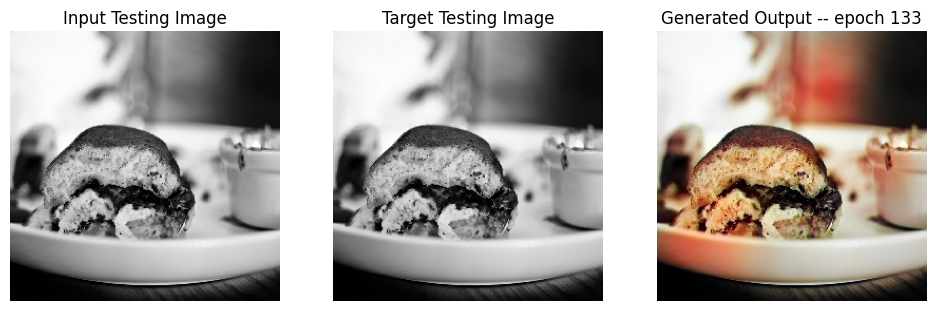

SSIM Score: 0.9467889666557312
PSNR Score: 19.804534912109375
Epoch 133
Training Details
Generator-- total_loss:4.81984 gan_loss:0.01709 l1_loss:0.04126 perceptual_loss:0.00846 Discriminator-- total_loss:10.03364 real_loss:10.03154 generated_loss:0.00209 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 134 is 263.6140694618225 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.12771 gan_loss:0.00009 l1_loss:0.04409  perceptual_loss:0.00898 Discriminator-- total_loss:14.93546 real_loss:14.93531 generated_loss:0.00015 --- SSIM 0.91939 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 134 is 285.272588968277 sec
Number of iteration 32
Epoch 134
Training Details
Generator-- total_loss:4.74425 gan_loss:0.01783 l1_loss:0.04064 perceptual_loss:0.00829 Discriminator-- total_loss:10.04940 real_loss:10.04923 generated_loss:0.00017 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 135 is 263.4660451412201 sec
Number of iteration 250
Validation Det

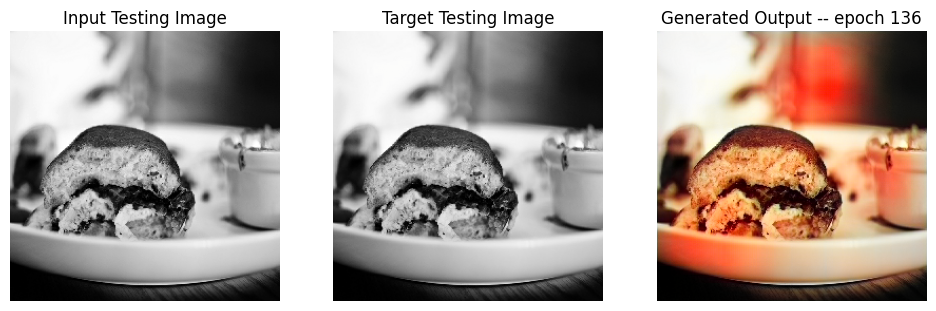

SSIM Score: 0.8713502287864685
PSNR Score: 15.157543182373047
Epoch 136
Training Details
Generator-- total_loss:4.77691 gan_loss:0.01594 l1_loss:0.04096 perceptual_loss:0.00831 Discriminator-- total_loss:9.43276 real_loss:9.43210 generated_loss:0.00066 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 137 is 263.6995692253113 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.33378 gan_loss:0.00008 l1_loss:0.04578  perceptual_loss:0.00945 Discriminator-- total_loss:15.63217 real_loss:15.63199 generated_loss:0.00019 --- SSIM 0.91305 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 137 is 285.3706023693085 sec
Number of iteration 32
Epoch 137
Training Details
Generator-- total_loss:4.76589 gan_loss:0.01651 l1_loss:0.04084 perceptual_loss:0.00832 Discriminator-- total_loss:10.14786 real_loss:10.14770 generated_loss:0.00016 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 138 is 265.1336181163788 sec
Number of iteration 250
Validation Deta

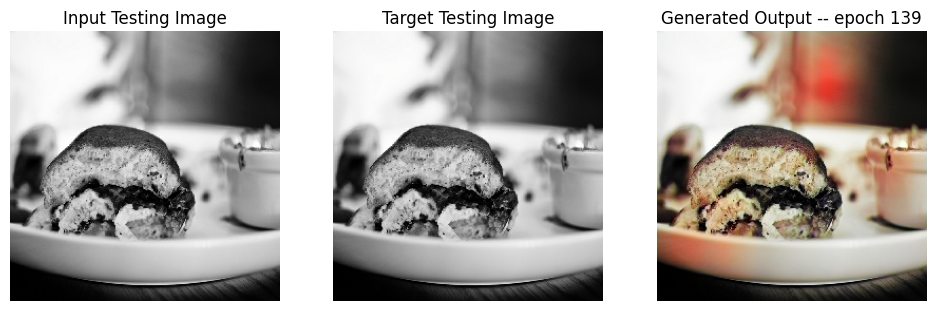

SSIM Score: 0.9596850275993347
PSNR Score: 21.299863815307617
Epoch 139
Training Details
Generator-- total_loss:4.76849 gan_loss:0.01577 l1_loss:0.04086 perceptual_loss:0.00834 Discriminator-- total_loss:9.74539 real_loss:9.74522 generated_loss:0.00016 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 140 is 265.90147137641907 sec
Number of iteration 250
Validation Details
Generator-- total_loss:6.79032 gan_loss:0.00003 l1_loss:0.06001  perceptual_loss:0.00986 Discriminator-- total_loss:20.33781 real_loss:20.33770 generated_loss:0.00012 --- SSIM 0.89379 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 140 is 287.3698103427887 sec
Number of iteration 32
Epoch 140
Training Details
Generator-- total_loss:4.81390 gan_loss:0.01525 l1_loss:0.04123 perceptual_loss:0.00845 Discriminator-- total_loss:9.97887 real_loss:9.97842 generated_loss:0.00045 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 141 is 263.8647553920746 sec
Number of iteration 250
Validation Detai

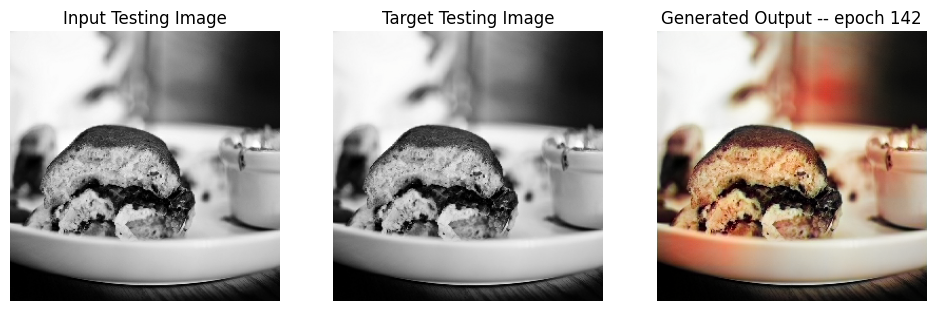

SSIM Score: 0.9518716335296631
PSNR Score: 20.1436710357666
Epoch 142
Training Details
Generator-- total_loss:12.72650 gan_loss:7.97183 l1_loss:0.04083 perceptual_loss:0.00840 Discriminator-- total_loss:0.09984 real_loss:0.02800 generated_loss:0.07185 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 143 is 200.74910068511963 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.27205 gan_loss:0.06216 l1_loss:0.04467  perceptual_loss:0.00929 Discriminator-- total_loss:5.50881 real_loss:5.41630 generated_loss:0.09251 --- SSIM 0.91398 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 143 is 222.28503155708313 sec
Number of iteration 32
Epoch 143
Training Details
Generator-- total_loss:13.00843 gan_loss:8.28902 l1_loss:0.04055 perceptual_loss:0.00830 Discriminator-- total_loss:0.03160 real_loss:0.01182 generated_loss:0.01977 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 144 is 199.8641757965088 sec
Number of iteration 250
Validation Detail

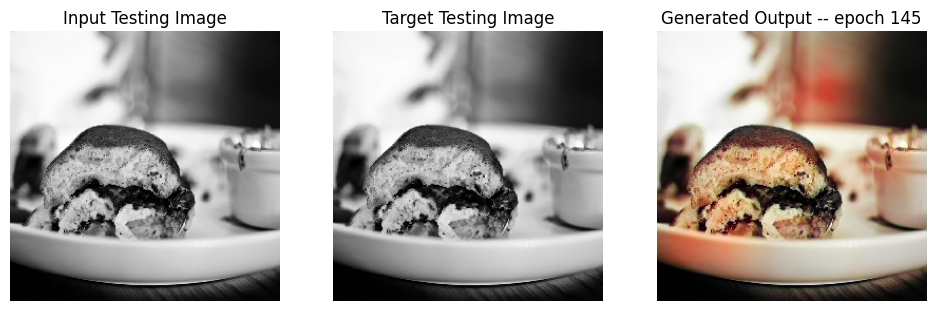

SSIM Score: 0.9546052813529968
PSNR Score: 20.4840145111084
Epoch 145
Training Details
Generator-- total_loss:12.85470 gan_loss:8.13740 l1_loss:0.04061 perceptual_loss:0.00820 Discriminator-- total_loss:0.06723 real_loss:0.01428 generated_loss:0.05294 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 146 is 200.873601436615 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.20934 gan_loss:0.04901 l1_loss:0.04434  perceptual_loss:0.00908 Discriminator-- total_loss:5.49360 real_loss:5.44084 generated_loss:0.05276 --- SSIM 0.91507 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 146 is 222.27746033668518 sec
Number of iteration 32
Epoch 146
Training Details
Generator-- total_loss:12.93630 gan_loss:8.16823 l1_loss:0.04089 perceptual_loss:0.00849 Discriminator-- total_loss:0.03812 real_loss:0.01108 generated_loss:0.02704 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 147 is 200.48614811897278 sec
Number of iteration 250
Validation Details

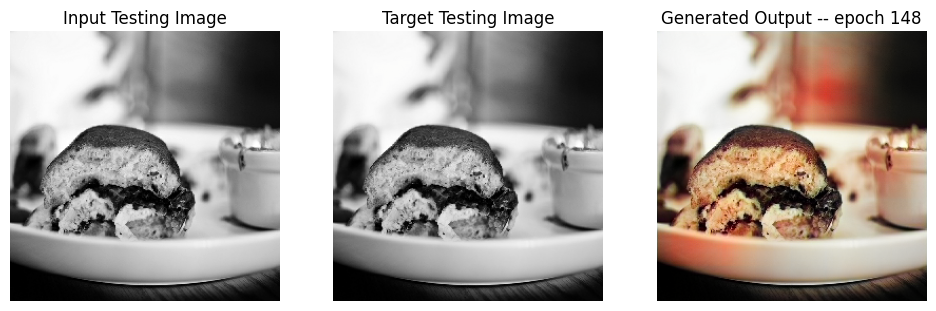

SSIM Score: 0.9505335688591003
PSNR Score: 20.047588348388672
Epoch 148
Training Details
Generator-- total_loss:13.05131 gan_loss:8.34374 l1_loss:0.04052 perceptual_loss:0.00820 Discriminator-- total_loss:0.03606 real_loss:0.01338 generated_loss:0.02268 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 149 is 200.8957016468048 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.28570 gan_loss:0.04673 l1_loss:0.04495  perceptual_loss:0.00930 Discriminator-- total_loss:5.29094 real_loss:5.24264 generated_loss:0.04830 --- SSIM 0.91878 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 149 is 222.01990294456482 sec
Number of iteration 32
Epoch 149
Training Details
Generator-- total_loss:13.13080 gan_loss:8.42130 l1_loss:0.04035 perceptual_loss:0.00843 Discriminator-- total_loss:0.02204 real_loss:0.00817 generated_loss:0.01387 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 150 is 201.7671730518341 sec
Number of iteration 250
Validation Detai

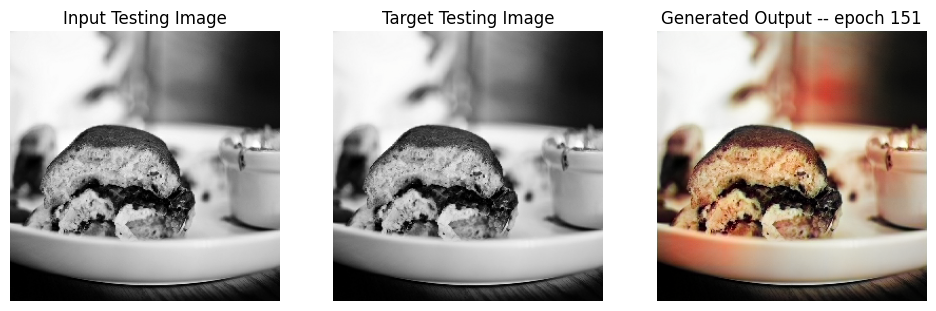

SSIM Score: 0.9548614025115967
PSNR Score: 20.503944396972656
Epoch 151
Training Details
Generator-- total_loss:13.02761 gan_loss:8.27382 l1_loss:0.04082 perceptual_loss:0.00839 Discriminator-- total_loss:0.02019 real_loss:0.00754 generated_loss:0.01265 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 152 is 202.38577437400818 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.39034 gan_loss:0.03723 l1_loss:0.04599  perceptual_loss:0.00942 Discriminator-- total_loss:5.94597 real_loss:5.90388 generated_loss:0.04209 --- SSIM 0.91169 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 152 is 223.7565996646881 sec
Number of iteration 32
Epoch 152
Training Details
Generator-- total_loss:13.96195 gan_loss:9.25245 l1_loss:0.04042 perceptual_loss:0.00835 Discriminator-- total_loss:0.01775 real_loss:0.00672 generated_loss:0.01103 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 153 is 203.037189245224 sec
Number of iteration 250
Validation Detail

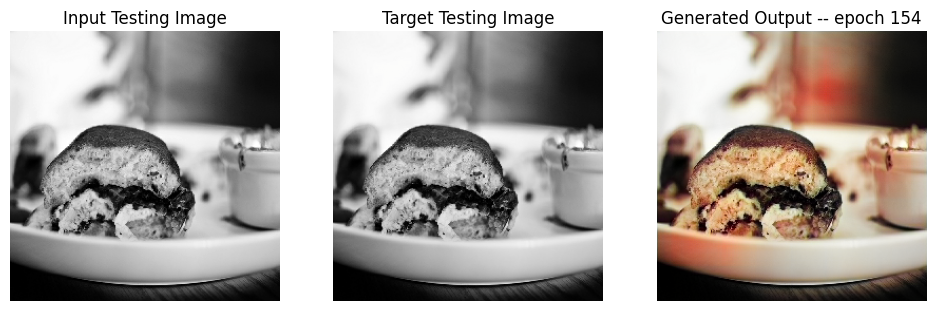

SSIM Score: 0.9551946520805359
PSNR Score: 20.55925750732422
Epoch 154
Training Details
Generator-- total_loss:13.12059 gan_loss:8.41884 l1_loss:0.04033 perceptual_loss:0.00836 Discriminator-- total_loss:0.02283 real_loss:0.00815 generated_loss:0.01468 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 155 is 201.97279739379883 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.30514 gan_loss:0.03009 l1_loss:0.04558  perceptual_loss:0.00896 Discriminator-- total_loss:6.25812 real_loss:6.22651 generated_loss:0.03161 --- SSIM 0.91271 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 155 is 223.5054702758789 sec
Number of iteration 32
Epoch 155
Training Details
Generator-- total_loss:14.29586 gan_loss:9.60870 l1_loss:0.04016 perceptual_loss:0.00839 Discriminator-- total_loss:0.00581 real_loss:0.00316 generated_loss:0.00265 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 156 is 203.25808596611023 sec
Number of iteration 250
Validation Detai

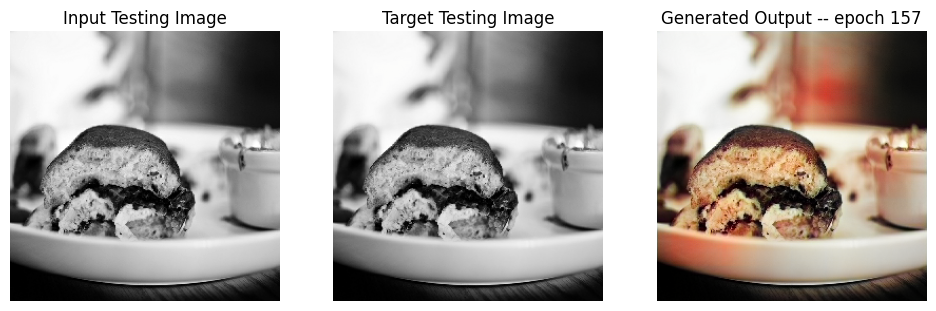

SSIM Score: 0.9535524249076843
PSNR Score: 20.412109375
Epoch 157
Training Details
Generator-- total_loss:13.81788 gan_loss:9.19025 l1_loss:0.03973 perceptual_loss:0.00819 Discriminator-- total_loss:0.02866 real_loss:0.00500 generated_loss:0.02366 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 158 is 202.76365447044373 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.28275 gan_loss:0.03820 l1_loss:0.04490  perceptual_loss:0.00944 Discriminator-- total_loss:5.51385 real_loss:5.47477 generated_loss:0.03908 --- SSIM 0.91362 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 158 is 224.17444777488708 sec
Number of iteration 32
Epoch 158
Training Details
Generator-- total_loss:14.32343 gan_loss:9.66504 l1_loss:0.03998 perceptual_loss:0.00825 Discriminator-- total_loss:0.00570 real_loss:0.00274 generated_loss:0.00295 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 159 is 202.39787983894348 sec
Number of iteration 250
Validation Details
G

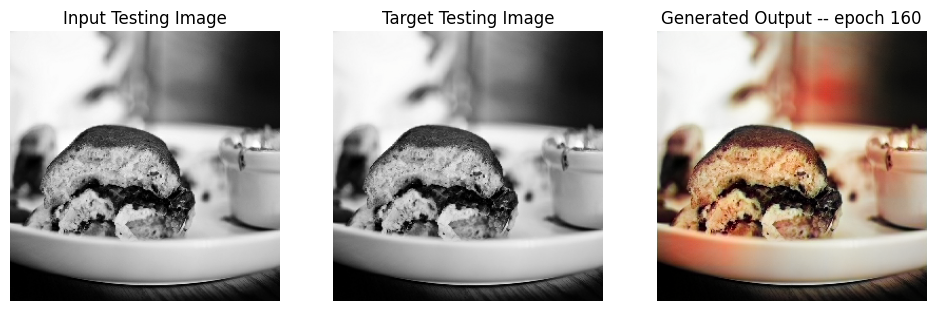

SSIM Score: 0.9516806602478027
PSNR Score: 20.185516357421875
Epoch 160
Training Details
Generator-- total_loss:13.98526 gan_loss:9.25467 l1_loss:0.04065 perceptual_loss:0.00832 Discriminator-- total_loss:0.02240 real_loss:0.01088 generated_loss:0.01151 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 161 is 201.92320370674133 sec
Number of iteration 250
Validation Details
Generator-- total_loss:5.15731 gan_loss:0.01286 l1_loss:0.04430  perceptual_loss:0.00893 Discriminator-- total_loss:6.68336 real_loss:6.66263 generated_loss:0.02073 --- SSIM 0.91819 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 161 is 223.48650908470154 sec
Number of iteration 32
Epoch 161
Training Details
Generator-- total_loss:14.14050 gan_loss:9.41225 l1_loss:0.04057 perceptual_loss:0.00840 Discriminator-- total_loss:0.00984 real_loss:0.00409 generated_loss:0.00576 --- SSIM 0.00000 PSNR 0.00000 LPIPS 0.00000
Time taken for epoch 162 is 203.58498311042786 sec
Number of iteration 250
Validation Det

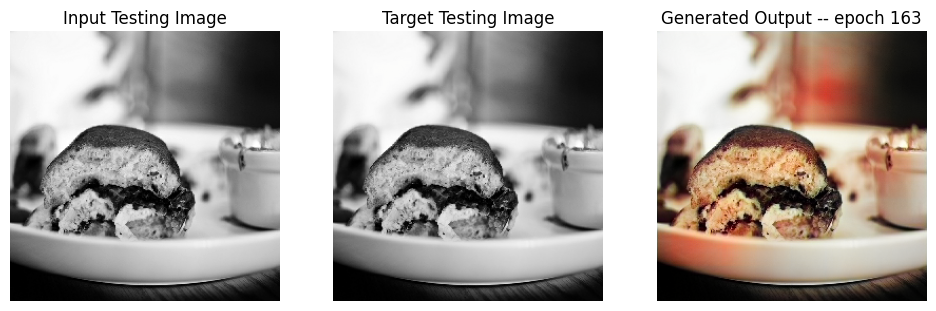

SSIM Score: 0.951376736164093
PSNR Score: 20.17399787902832


In [50]:
fit(train_dataset, epochs, val, gen)

/tmp/ipykernel_27/1385076028.py:4: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-or" (-> color='r'). The keyword argument will take precedence.
  plt.plot(epochs, train_discriminator_losses, '-or', color='orange', label='Discriminator Loss')


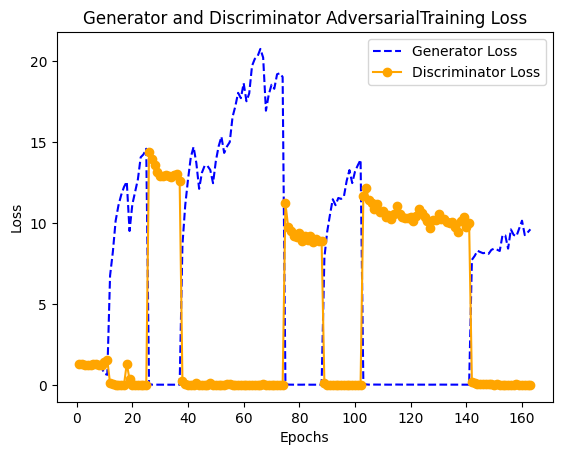

In [51]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_generator_gan_losses, '--b', label='Generator Loss')
plt.plot(epochs, train_discriminator_losses, '-or', color='orange', label='Discriminator Loss')
plt.title('Generator and Discriminator AdversarialTraining Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/train_loss_plot_1.png')
plt.show()

/tmp/ipykernel_27/4010479747.py:4: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-or" (-> color='r'). The keyword argument will take precedence.
  plt.plot(epochs, test_discriminator_losses, '-or', color='orange', label='Discriminator Loss')


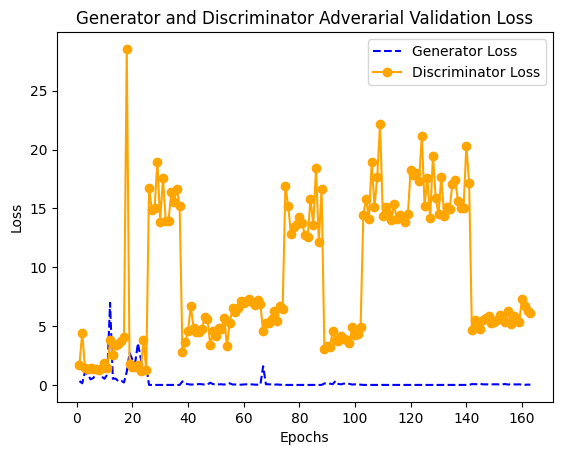

In [52]:
epochs = range(1, len(test_generator_losses) + 1)

plt.plot(epochs, test_generator_gan_losses, '--b', label='Generator Loss')
plt.plot(epochs, test_discriminator_losses, '-or', color='orange', label='Discriminator Loss')
plt.title('Generator and Discriminator Adverarial Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/test_loss_plot_1.png')
plt.show()

/tmp/ipykernel_27/825315398.py:4: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-or" (-> color='r'). The keyword argument will take precedence.
  plt.plot(epochs, testing_ssim, '-or', color='orange', label='Validation SSIM')


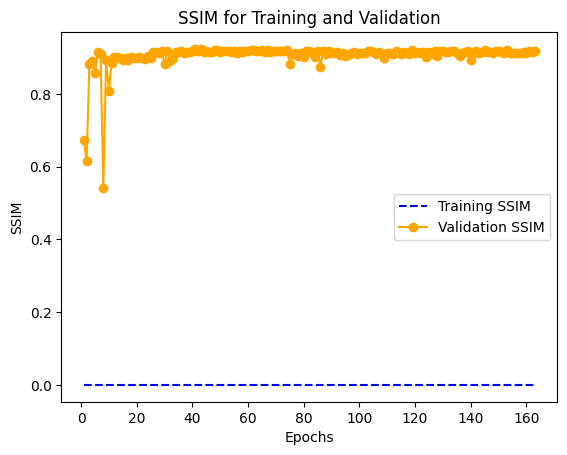

In [53]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, training_ssim, '--b', label='Training SSIM')
plt.plot(epochs, testing_ssim, '-or', color='orange', label='Validation SSIM')
plt.title('SSIM for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('SSIM')
plt.legend()
plt.savefig('/kaggle/working/SSIM_plot_1.png')
plt.show()

/tmp/ipykernel_27/1818322218.py:4: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-or" (-> color='r'). The keyword argument will take precedence.
  plt.plot(epochs, testing_psnr, '-or', color='orange', label='Validation PSNR')


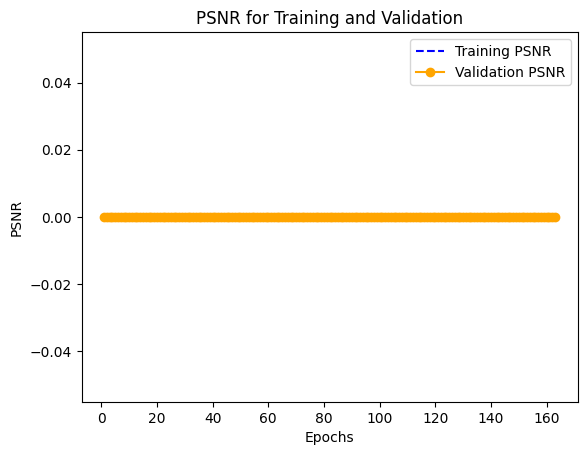

In [54]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, training_psnr, '--b', label='Training PSNR')
plt.plot(epochs, testing_psnr, '-or', color='orange', label='Validation PSNR')
plt.title('PSNR for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('PSNR')
plt.legend()
plt.savefig('/kaggle/working/PSNR_plot_1.png')
plt.show()

/tmp/ipykernel_27/136468053.py:4: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-or" (-> color='r'). The keyword argument will take precedence.
  plt.plot(epochs, testing_lpips, '-or', color='orange', label='Validation LPIPS')


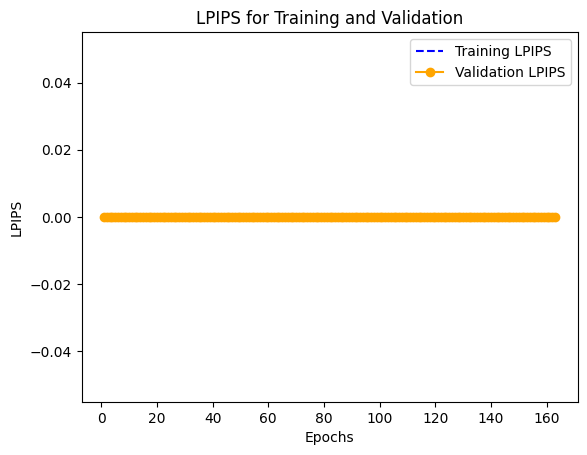

In [55]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, training_lpips, '--b', label='Training LPIPS')
plt.plot(epochs, testing_lpips, '-or', color='orange', label='Validation LPIPS')
plt.title('LPIPS for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('LPIPS')
plt.legend()
plt.savefig('/kaggle/working/LPIPS_plot_1.png')
plt.show()

/tmp/ipykernel_27/3235268261.py:4: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-or" (-> color='r'). The keyword argument will take precedence.
  plt.plot(epochs, test_generator_gan_losses,'-or', color='orange', label='Validation_Generator_GAN_Loss')


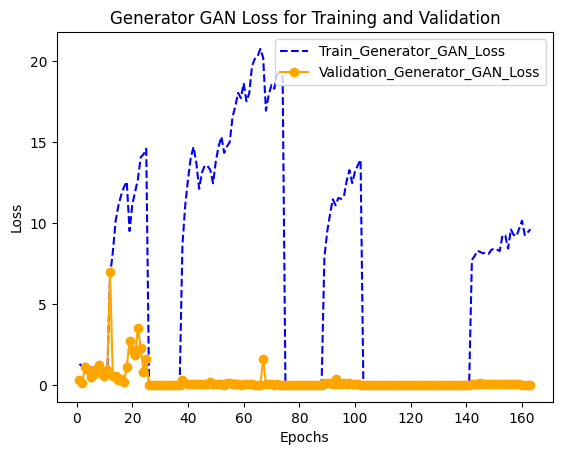

In [56]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_generator_gan_losses, '--b', label='Train_Generator_GAN_Loss')
plt.plot(epochs, test_generator_gan_losses,'-or', color='orange', label='Validation_Generator_GAN_Loss')
plt.title('Generator GAN Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Gen_GAN_plot_1.png')
plt.show()

/tmp/ipykernel_27/271018654.py:4: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-or" (-> color='r'). The keyword argument will take precedence.
  plt.plot(epochs, test_generator_l1_losses, '-or', color='orange', label='Validation_Generator_L1_Loss')


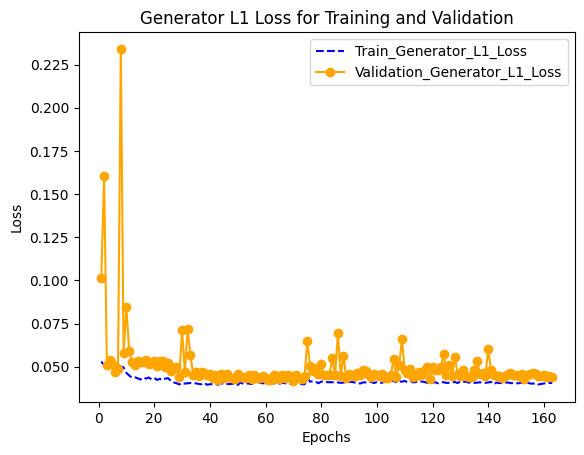

In [57]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_generator_l1_losses, '--b', label='Train_Generator_L1_Loss')
plt.plot(epochs, test_generator_l1_losses, '-or', color='orange', label='Validation_Generator_L1_Loss')
plt.title('Generator L1 Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Gen_L1_plot_1.png')
plt.show()

/tmp/ipykernel_27/1114805691.py:4: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-or" (-> color='r'). The keyword argument will take precedence.
  plt.plot(epochs, test_generator_perceptual_losses, '-or', color='orange', label='Validation_Generator_Perceptual_Loss')


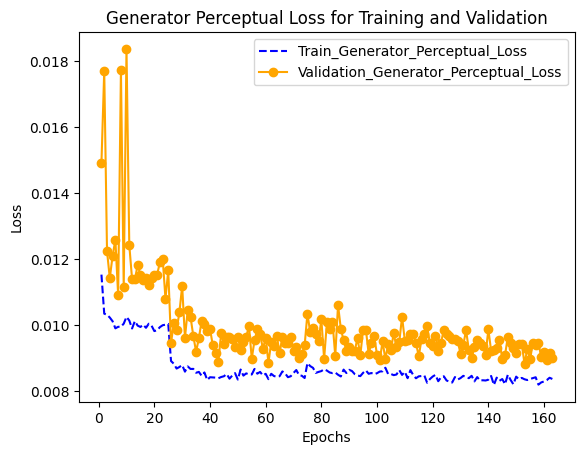

In [58]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_generator_perceptual_losses, '--b', label='Train_Generator_Perceptual_Loss')
plt.plot(epochs, test_generator_perceptual_losses, '-or', color='orange', label='Validation_Generator_Perceptual_Loss')
plt.title('Generator Perceptual Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Gen_Perceptual_plot_1.png')
plt.show()

/tmp/ipykernel_27/1582919640.py:4: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-or" (-> color='r'). The keyword argument will take precedence.
  plt.plot(epochs, test_generator_losses, '-or', color='orange', label='Validation_Generator_Loss')


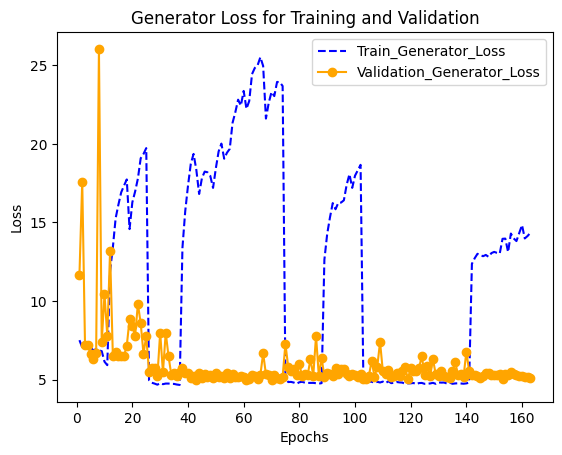

In [59]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_generator_losses, '--b', label='Train_Generator_Loss')
plt.plot(epochs, test_generator_losses, '-or', color='orange', label='Validation_Generator_Loss')
plt.title('Generator Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Gen_plot_1.png')
plt.show()

/tmp/ipykernel_27/1374437368.py:4: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-or" (-> color='r'). The keyword argument will take precedence.
  plt.plot(epochs, test_discriminator_losses, '-or', color='orange', label='Validation_Discriminator_Loss')


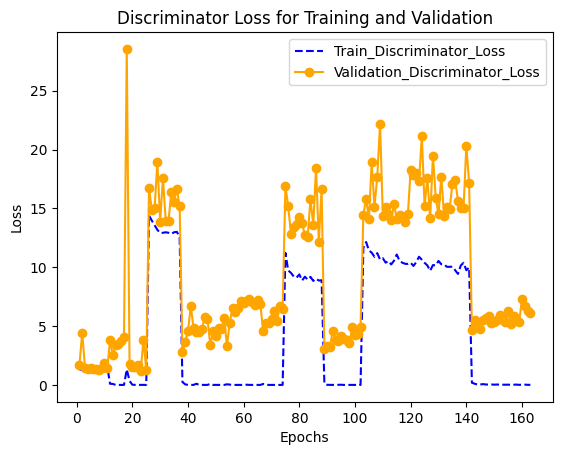

In [60]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_discriminator_losses, '--b', label='Train_Discriminator_Loss')
plt.plot(epochs, test_discriminator_losses, '-or', color='orange', label='Validation_Discriminator_Loss')
plt.title('Discriminator Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Disc_plot_1.png')
plt.show()

/tmp/ipykernel_27/1497767744.py:4: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-or" (-> color='r'). The keyword argument will take precedence.
  plt.plot(epochs, test_discriminator_real_losses, '-or', color='orange', label='Validation_Discriminator_Real_Loss')


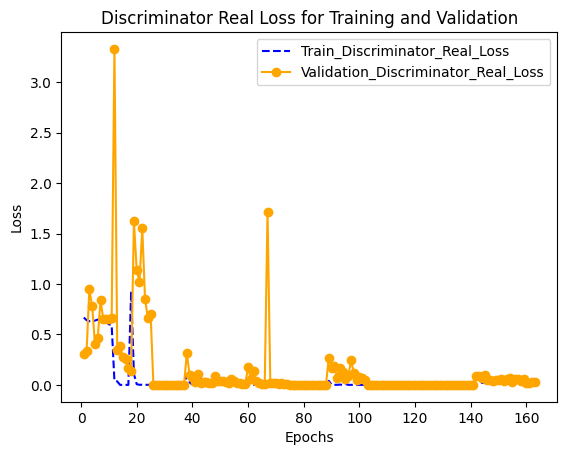

In [61]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_discriminator_real_losses, '--b', label='Train_Discriminator_Real_Loss')
plt.plot(epochs, test_discriminator_real_losses, '-or', color='orange', label='Validation_Discriminator_Real_Loss')
plt.title('Discriminator Real Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Disc_Real_plot_1.png')
plt.show()

/tmp/ipykernel_27/1197813443.py:4: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-or" (-> color='r'). The keyword argument will take precedence.
  plt.plot(epochs, test_discriminator_generated_losses,'-or', color='orange', label='Validation_Discriminator_Generated_Loss')


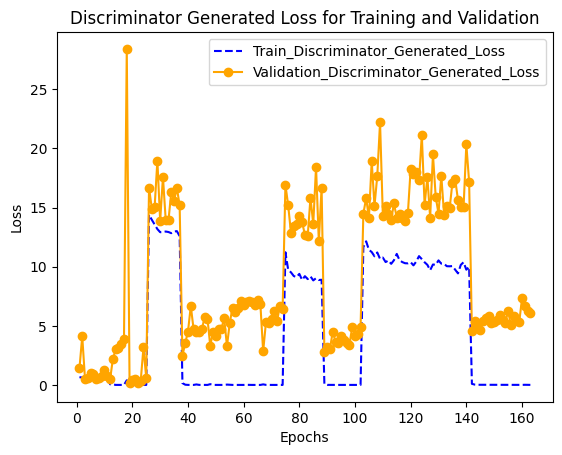

In [62]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_discriminator_generated_losses, '--b', label='Train_Discriminator_Generated_Loss')
plt.plot(epochs, test_discriminator_generated_losses,'-or', color='orange', label='Validation_Discriminator_Generated_Loss')
plt.title('Discriminator Generated Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Disc_Generated_plot_1.png')
plt.show()

In [63]:
import csv
with open('/kaggle/working/dataJan20.csv','w', newline='') as file:
    writer = csv.writer(file)
    writer.writerows(all_records)

In [64]:
# # Evaluation on testing data


# each_epoch_test_lpips = []
# each_epoch_test_psnr = []
# each_epoch_test_ssim = []
# each_epoch_test_fid = []
# each_epoch_test_generator_losses = []
# each_epoch_test_generator_gan_losses = []
# each_epoch_test_generator_l1_losses = []
# each_epoch_test_generator_l2_losses = []
# each_epoch_test_generator_perceptual_losses = []
# each_epoch_test_discriminator_losses = []
# each_epoch_test_discriminator_real_losses = []
# each_epoch_test_discriminator_generated_losses = []

# for n, (input_, target) in test_dataset.enumerate():
#     test_gen_loss, test_gen_gan_loss, test_gen_l1_loss, test_gen_perceptual_loss, test_disc_loss, test_disc_real_loss, test_disc_generated_loss, test_ssim, test_psnr, test_lpips, test_fid = test_step(input_, target)

#     each_epoch_test_generator_losses.append(test_gen_loss)
#     each_epoch_test_generator_gan_losses.append(test_gen_gan_loss)
#     each_epoch_test_generator_l1_losses.append(test_gen_l1_loss)
# #             each_epoch_test_generator_l2_losses.append(test_gen_l2_loss)
#     each_epoch_test_generator_perceptual_losses.append(test_gen_perceptual_loss)
#     each_epoch_test_discriminator_losses.append(test_disc_loss)
#     each_epoch_test_discriminator_real_losses.append(test_disc_real_loss)
#     each_epoch_test_discriminator_generated_losses.append(test_disc_generated_loss)
#     each_epoch_test_ssim.append(tf.reduce_mean(test_ssim.numpy()))
#     each_epoch_test_psnr.append(tf.reduce_mean(test_psnr.numpy()))
#     each_epoch_test_lpips.append(tf.reduce_mean(test_lpips.numpy()))
#     each_epoch_test_fid.append(test_fid)
#     print(test_fid)

# print("Testing Details")
# print("Generator-- total_loss:{:.5f} gan_loss:{:.5f} l1_loss:{:.5f}  perceptual_loss:{:.5f} \nDiscriminator-- total_loss:{:.5f} real_loss:{:.5f} generated_loss:{:.5f} --- \nSSIM {:.5f} \nPSNR {:.5f} \nLPIPS {:.5f} \nFID Score: {:.5f}".format(np.mean(each_epoch_test_generator_losses),np.mean(each_epoch_test_generator_gan_losses), np.mean(each_epoch_test_generator_l1_losses), np.mean(each_epoch_test_generator_perceptual_losses),np.mean(each_epoch_test_discriminator_losses), np.mean(each_epoch_test_discriminator_generated_losses), np.mean(each_epoch_test_discriminator_real_losses), np.mean(each_epoch_test_ssim), np.mean(each_epoch_test_psnr), np.mean(each_epoch_test_lpips), np.mean(each_epoch_test_fid)))

In [65]:
os.mkdir('/kaggle/working/modelsFeb7')

In [66]:
gen.save('/kaggle/working/modelsFeb7/gen.h5')
gen.save_weights('/kaggle/working/modelsFeb7/gen_weight.keras')
disc.save('/kaggle/working/modelsFeb7/disc.h5')
disc.save_weights('/kaggle/working/modelsFeb7/disc_wweight.keras')

/opt/conda/lib/python3.10/site-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [67]:
def download_file(path, download_file_name):
    os.chdir('/kaggle/working/')
    zip_name = f"/kaggle/working/{download_file_name}.zip"
    command = f"zip {zip_name} {path} -r"
    result = subprocess.run(command, shell=True, capture_output=True, text=True)
    if result.returncode !=0:
        print("Unable to run zip command")
        print(result.stderr)
        return
    display(FileLink(f'{download_file_name}.zip'))

In [68]:
import subprocess
from IPython.display import FileLink, display

In [69]:
download_file('/kaggle/working', 'outputFeb10')

/kaggle/working/outputFeb10.zip